In [2]:

# ==========================================
# IMPORTS
# ==========================================
import h5py
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as T
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import autocast, GradScaler
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os
import warnings

# Suppress warnings
warnings.filterwarnings('ignore')

In [ ]:
# 1. HYPERPARAMETERS (Optimized and Fixed)
# ==========================================
CONFIG = {
    'batch_size': 256,        
    'lr': 1e-4,               # Base learning rate
    'warmup_epochs': 10,       # Learning rate warmup
    'weight_decay': 0.05,
    'epochs': 300,             
    'img_size': 224,
    'embed_dim': 192,
    'num_heads': 3,
    'enc_depth': 6,
    'pred_depth': 6,
    'patch_size': 16,
    'device': 'cuda' if torch.cuda.is_available() else 'cpu',
    'mask_scale': (0.2, 0.3),
    'context_scale': (0.5, 0.7),
    'num_targets': 4,         # Number of target blocks
    'ema_momentum_base': 0.996,  # Will be adjusted based on epochs
    'patience': 10,           # Early stopping patience
    'min_context_patches': 20,  # Minimum visible patches in context
    'center_crop_size': 140,  # Crop size for galaxies
}
# Adjust EMA momentum based on training length
if CONFIG['epochs'] < 100:
    CONFIG['ema_momentum'] = 0.99  # Lower momentum for shorter training
else:
    CONFIG['ema_momentum'] = CONFIG['ema_momentum_base']

print(f"Running on: {CONFIG['device']}")
print(f"Training for {CONFIG['epochs']} epochs with EMA momentum: {CONFIG['ema_momentum']}")

Running on: cuda
Training for 300 epochs with EMA momentum: 0.996


In [4]:

# ==========================================
# 2. DATASET
# ==========================================
class Galaxy10FullDataset(Dataset):
    """
    Galaxy10 Dataset that loads all data into RAM for fast training.
    """
    def __init__(self, file_path, transform=None):
        self.transform = transform
        
        if not os.path.exists(file_path):
            raise FileNotFoundError(f"Dataset file not found: {file_path}")

        try:
            print(f"Loading {file_path} into RAM...")
            with h5py.File(file_path, "r") as f:
                self.images = f["images"][:]  # Shape: (N, 256, 256, 3)
                self.labels = f["ans"][:]
            
            # Ensure correct type for PIL (0-255 uint8)
            self.images = self.images.astype(np.uint8)
            self.N = len(self.images)
            print(f"✓ Loaded {self.N} images into RAM. Ready to train.")
            
        except Exception as e:
            raise RuntimeError(f"Failed to load dataset: {str(e)}")

    def __len__(self):
        return self.N

    def __getitem__(self, idx):
        img = self.images[idx]
        label = self.labels[idx]

        # Convert to PIL Image for torchvision transforms
        img = Image.fromarray(img)

        if self.transform:
            img = self.transform(img)

        return img, int(label)


class TransformDataset(Dataset):
    """
    Wraps any dataset or subset and applies a new transform
    without modifying the original dataset.
    """
    def __init__(self, subset, transform):
        self.subset = subset
        self.transform = transform

    def __len__(self):
        return len(self.subset)

    def __getitem__(self, idx):
        item = self.subset[idx]

        if isinstance(item, tuple):
            img, label = item
            return self.transform(img), label

        return self.transform(item)



In [5]:
import torch
import numpy as np

# ==========================================
# 3. MASKING UTILITIES (Galaxy-aware JEPA)
# ==========================================
class IJepaMaskCollator:
    """
    Galaxy-aware masking collator for Mini-JEPA on Galaxy10.

    Returns:
        images:        (B, C, H, W)
        context_mask:  (B, N) bool, True = visible to context encoder
        target_masks:  list of length num_targets, each (B, N) bool, True = target block
    """

    def __init__(
        self,
        input_size=224,
        patch_size=32,
        enc_mask_scale=(0.4, 0.8),   # size of VISIBLE context block, in fraction of grid dims
        pred_mask_scale=(0.2, 0.3),  # size of each TARGET block, in fraction of grid dims
        num_targets=4,
        min_context_patches=10
    ):
        self.input_size = input_size
        self.patch_size = patch_size

        self.H = input_size // patch_size   # patch grid height
        self.W = input_size // patch_size   # patch grid width
        self.N = self.H * self.W

        self.enc_mask_scale = enc_mask_scale
        self.pred_mask_scale = pred_mask_scale
        self.num_targets = num_targets
        self.min_context_patches = min_context_patches

    # ------------------------------------------------------
    def __call__(self, batch):
        """
        batch: list of (image, label) or (image,)
        """
        # Extract images only
        images = torch.stack([item[0] for item in batch])  # (B, C, H, W)
        B = images.shape[0]

        # 1. Compute brightness per patch (so we know where the galaxy actually is)
        brightness = self._compute_patch_brightness(images)  # (B, H, W)

        # 2. Sample target masks (what the predictor must reconstruct)
        target_masks = []
        for _ in range(self.num_targets):
            t_mask = self._sample_semantic_block(brightness, self.pred_mask_scale)  # (B, N)
            target_masks.append(t_mask)

        # Combine all target blocks
        full_target_mask = torch.stack(target_masks, dim=0).any(dim=0)  # (B, N)

        # 3. Sample context mask (what the context encoder sees)
        #    This block represents the VISIBLE region.
        context_mask = self._sample_semantic_block(brightness, self.enc_mask_scale)  # (B, N)

        # Remove any overlap with target blocks
        context_mask = context_mask & (~full_target_mask)

        # 4. Ensure enough context patches remain
        for b in range(B):
            if context_mask[b].sum() < self.min_context_patches:
                # Fallback: allow every non-target patch to be context
                context_mask[b] = ~full_target_mask[b]
                # Still possible this is all False if target covers everything,
                # but with reasonable scales that should never happen.

        return images, context_mask, target_masks

    # ------------------------------------------------------
    def _compute_patch_brightness(self, imgs):
        """
        Compute mean absolute brightness per patch.

        imgs: (B, C, H, W), normalized, can be in [-1,1] or similar.
        Returns: (B, H_patches, W_patches)
        """
        B, C, H, W = imgs.shape
        assert H == self.input_size and W == self.input_size, \
            f"Expected images of size {self.input_size}x{self.input_size}, got {H}x{W}"

        # Approx "grayscale" intensity
        gray = imgs.mean(dim=1).abs()  # (B, H, W)

        # Fold into patches of size patch_size x patch_size
        p = self.patch_size
        Hp = H // p
        Wp = W // p

        # unfold: (B, Hp, Wp, p, p)
        patches = gray.unfold(1, p, p).unfold(2, p, p)
        # Mean brightness per patch
        brightness = patches.mean(dim=(-1, -2))  # (B, Hp, Wp)

        return brightness

    # ------------------------------------------------------
    def _sample_semantic_block(self, brightness, scale):
        """
        Sample a block of patches per image, biased toward bright (galaxy) regions.

        brightness: (B, H, W)
        scale: (min_frac, max_frac) of grid dims for block size
        Returns:
            mask: (B, N) bool, True where block is active (visible or target)
        """
        B, H, W = brightness.shape
        mask = torch.zeros(B, H, W, dtype=torch.bool)

        min_s, max_s = scale

        for b in range(B):
            br = brightness[b]  # (H, W)

            # pick block size as a fraction of grid dims
            block_h = np.random.randint(
                max(1, int(H * min_s)),
                max(1, int(H * max_s)) + 1
            )
            block_w = np.random.randint(
                max(1, int(W * min_s)),
                max(1, int(W * max_s)) + 1
            )

            # probability from brightness
            prob = br.flatten()  # (H*W,)

            # sanitize probs
            prob = torch.nan_to_num(prob, nan=0.0, posinf=0.0, neginf=0.0)
            prob = torch.clamp(prob, min=0.0)

            if prob.sum() <= 0:
                # if galaxy is very faint, fall back to uniform
                prob = torch.ones_like(prob)

            prob = prob / prob.sum()

            # sample center location
            idx = torch.multinomial(prob, 1).item()
            cy = idx // W
            cx = idx % W

            # convert center → top-left
            y0 = int(max(0, cy - block_h // 2))
            x0 = int(max(0, cx - block_w // 2))

            # clamp to stay inside grid
            y0 = min(y0, H - block_h)
            x0 = min(x0, W - block_w)

            y1 = y0 + block_h
            x1 = x0 + block_w

            mask[b, y0:y1, x0:x1] = True

        return mask.view(B, H * W)


In [6]:
# ==========================================
# 4. MODEL COMPONENTS
# ==========================================
class PatchEmbed(nn.Module):
    """Image to Patch Embedding"""
    def __init__(self, img_size=224, patch_size=16, in_chans=3, embed_dim=192):
        super().__init__()
        self.proj = nn.Conv2d(in_chans, embed_dim, kernel_size=patch_size, stride=patch_size)
        
    def forward(self, x):
        x = self.proj(x)  # (B, C, H, W)
        x = x.flatten(2).transpose(1, 2)  # (B, N, C), where C is the emb_dim now
        return x


class MiniViT(nn.Module):
    """Mini Vision Transformer"""
    def __init__(self, num_patches=196, embed_dim=192, depth=3, num_heads=3):
        super().__init__()
        self.pos_embed = nn.Parameter(torch.zeros(1, num_patches, embed_dim))

        encoder_layer = nn.TransformerEncoderLayer(
            d_model=embed_dim,
            nhead=num_heads,
            dim_feedforward=embed_dim * 4,
            batch_first=True,
            norm_first=True
        )
        self.blocks = nn.TransformerEncoder(encoder_layer, num_layers=depth)
        self.norm = nn.LayerNorm(embed_dim)

        self._init_weights()

    def _init_weights(self):
        nn.init.trunc_normal_(self.pos_embed, std=0.02)

    def forward(self, x, padding_mask=None):
        # x: (B, N, C)
        # padding_mask: (B, N) where True means "Ignore this token"
        x = self.blocks(x, src_key_padding_mask=padding_mask)
        return self.norm(x)


class MiniJEPA(nn.Module):
    """Mini JEPA Model"""
    def __init__(self, config):
        super().__init__()
        self.config = config
        
        # 1. Shared patch embedding
        self.patch_embed = PatchEmbed(
            img_size=config['img_size'],
            patch_size=config['patch_size'],
            embed_dim=config['embed_dim']
        )

        num_patches = (config['img_size'] // config['patch_size']) ** 2
        
        # 2. Context and target encoders
        self.context_encoder = MiniViT(
            num_patches=num_patches,
            embed_dim=config['embed_dim'],
            depth=config['enc_depth'],
            num_heads=config['num_heads']
        )
        self.target_encoder = MiniViT(
            num_patches=num_patches,
            embed_dim=config['embed_dim'],
            depth=config['enc_depth'],
            num_heads=config['num_heads']
        )

        # 3. Predictor
        self.predictor = MiniViT(
            num_patches=num_patches,
            embed_dim=config['embed_dim'],
            depth=config['pred_depth'],
            num_heads=config['num_heads']
        )

        self.mask_token = nn.Parameter(torch.zeros(1, 1, config['embed_dim']))

        self._init_weights()

        # Copy context encoder weights into target encoder and freeze
        self.target_encoder.load_state_dict(self.context_encoder.state_dict())
        for p in self.target_encoder.parameters():
            p.requires_grad = False

    def _init_weights(self):
        nn.init.trunc_normal_(self.mask_token, std=0.02)
        
    def count_parameters(self):
        """Count trainable parameters"""
        return sum(p.numel() for p in self.parameters() if p.requires_grad)

    def forward_target(self, images):
        """Forward pass through target encoder"""
        x = self.patch_embed(images)
        x = x + self.target_encoder.pos_embed
        x = self.target_encoder(x)
        return x

    def forward_context(self, images, context_mask):
        """Forward pass through context encoder"""
        x = self.patch_embed(images)
        x = x + self.context_encoder.pos_embed

        # PyTorch Transformer uses True = ignore, so invert
        padding_mask = ~context_mask.bool()

        x = self.context_encoder(x, padding_mask=padding_mask)
        return x

    def forward_predictor(self, context_output, target_masks):
        """Predict target representations from context"""
        B, N, C = context_output.shape
        predictions = []

        pos_embed_expanded = self.predictor.pos_embed.expand(B, N, C)

        for t_mask in target_masks:
            t_mask = t_mask.bool()

            pred_input = context_output.clone()
            pred_input = pred_input + pos_embed_expanded

            mask_tokens = self.mask_token.expand(B, N, C)
            pred_input[t_mask] = mask_tokens[t_mask] + pos_embed_expanded[t_mask]

            out = self.predictor(pred_input)
            predictions.append(out)

        return predictions


In [7]:


# ==========================================
# 5. TRAINING UTILITIES
# ==========================================
class EarlyStopping:
    """Early stopping handler"""
    def __init__(self, patience=10, min_delta=0.0001):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.counter = 0


def get_lr_schedule(optimizer, warmup_epochs, total_epochs):
    """Learning rate warmup + cosine decay"""
    def lr_lambda(epoch):
        if epoch < warmup_epochs:
            return (epoch + 1) / warmup_epochs
        else:
            progress = (epoch - warmup_epochs) / (total_epochs - warmup_epochs)
            return 0.5 * (1 + np.cos(np.pi * progress))
    
    return torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda)


In [8]:
# Define data path
data_path = "/kaggle/input/galaxy10-decals/Galaxy10_DECals.h5"


# Training augmentations (strong augmentation to prevent collapse)
train_transform = T.Compose([
    T.CenterCrop(CONFIG['center_crop_size']),  # Zoom in on galaxy
    T.RandomRotation(180),      # Galaxies rotate!
    T.RandomHorizontalFlip(),   # Chirality invariance
    T.Resize((CONFIG['img_size'], CONFIG['img_size'])),
    T.ToTensor(),
    T.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
])

# Test transform (no random augmentation!)
test_transform = T.Compose([
    T.CenterCrop(CONFIG['center_crop_size']),
    T.Resize((CONFIG['img_size'], CONFIG['img_size'])),
    T.ToTensor(),
    T.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
])

print("=" * 60)
print("Initializing Dataset")
print("=" * 60)


full_dataset = Galaxy10FullDataset(file_path=data_path, transform=None)


# Split dataset
train_size = int(0.9 * len(full_dataset))
test_size = len(full_dataset) - train_size
train_subset, test_subset = random_split(
    full_dataset, 
    [train_size, test_size],
    generator=torch.Generator().manual_seed(42)  # Reproducible split
)

# Apply transforms
train_subset = TransformDataset(train_subset, train_transform)
test_subset = TransformDataset(test_subset, test_transform)

# Create collator
collator = IJepaMaskCollator(
    input_size=CONFIG['img_size'],
    patch_size=CONFIG['patch_size'],
    enc_mask_scale=CONFIG['context_scale'],
    pred_mask_scale=CONFIG['mask_scale'],
    num_targets=CONFIG['num_targets'],
    min_context_patches=CONFIG['min_context_patches']
)

# DataLoaders (num_workers=0 since data is in RAM)
train_loader = DataLoader(
    train_subset, 
    batch_size=CONFIG['batch_size'], 
    shuffle=True,
    collate_fn=collator, 
    drop_last=True, 
    num_workers=2,  # 0 for in-RAM dataset
    pin_memory=True
)
test_loader = DataLoader(
    test_subset, 
    batch_size=CONFIG['batch_size'], 
    shuffle=False,
    collate_fn=collator, 
    drop_last=False, 
    num_workers=3,
    pin_memory=True
)

print(f"✓ Train samples: {len(train_subset)}, Test samples: {len(test_subset)}")
print(f"✓ Train batches: {len(train_loader)}, Test batches: {len(test_loader)}")

# Initialize model
print("\n" + "=" * 60)
print("Initializing Model")
print("=" * 60)

model = MiniJEPA(CONFIG).to(CONFIG['device'])
print(f"✓ Model parameters: {model.count_parameters():,}")

# Optimizer and scheduler
optimizer = optim.AdamW(
    model.parameters(), 
    lr=CONFIG['lr'], 
    weight_decay=CONFIG['weight_decay']
)
scheduler = get_lr_schedule(
    optimizer, 
    CONFIG['warmup_epochs'], 
    CONFIG['epochs']
)
scaler = GradScaler()
early_stopping = EarlyStopping(patience=CONFIG['patience'])


Initializing Dataset
Loading /kaggle/input/galaxy10-decals/Galaxy10_DECals.h5 into RAM...
✓ Loaded 17736 images into RAM. Ready to train.
✓ Train samples: 15962, Test samples: 1774
✓ Train batches: 62, Test batches: 7

Initializing Model
✓ Model parameters: 5,562,240


In [ ]:
# ==========================================
# 6. TRAINING LOOP
# ==========================================
def train():

    # Training history
    history = {
        'train_loss': [],
        'val_loss': [],
        'lr': []
    }
    best_val_loss = float('inf')

    print("\n" + "=" * 60)
    print(f"Starting Training on {CONFIG['device']}")
    print("=" * 60)

    for epoch in range(CONFIG["epochs"]):
        # ============ TRAINING ============
        model.train()
        total_loss = 0.0
        num_batches = 0

        for i, (images, context_mask, target_masks) in enumerate(train_loader):
            images = images.to(CONFIG["device"], non_blocking=True)
            context_mask = context_mask.to(CONFIG["device"], non_blocking=True)
            target_masks = [m.to(CONFIG["device"], non_blocking=True) for m in target_masks]

            optimizer.zero_grad(set_to_none=True)

            try:
                with autocast():
                    # Forward pass
                    with torch.no_grad():
                        target_output = model.forward_target(images)
                    
                    context_output = model.forward_context(images, context_mask)
                    predictions = model.forward_predictor(context_output, target_masks)

                    # Compute loss
                    loss = 0.0
                    valid_blocks = 0
                    for pred, t_mask in zip(predictions, target_masks):
                        n_masked = t_mask.sum()
                        if n_masked == 0:
                            continue
                        loss += F.mse_loss(pred[t_mask], target_output[t_mask])
                        valid_blocks += 1

                    if valid_blocks == 0:
                        continue  # Skip this batch
                    
                    loss = loss / valid_blocks

                # Check for NaN/Inf
                if not torch.isfinite(loss):
                    print(f"Warning: Non-finite loss detected at epoch {epoch+1}, batch {i}")
                    continue

                # Backward pass
                scaler.scale(loss).backward()
                scaler.unscale_(optimizer)
                torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
                scaler.step(optimizer)
                scaler.update()

                # EMA Update for target encoder
                with torch.no_grad():
                    m = CONFIG['ema_momentum']
                    for param_q, param_k in zip(
                        model.context_encoder.parameters(), 
                        model.target_encoder.parameters()
                    ):
                        param_k.data.mul_(m).add_((1.0 - m) * param_q.data)

                total_loss += loss.item()
                num_batches += 1

            except RuntimeError as e:
                if "out of memory" in str(e):
                    print(f"OOM at epoch {epoch+1}, batch {i}. Skipping...")
                    torch.cuda.empty_cache()
                    continue
                else:
                    raise e

        # Update learning rate
        scheduler.step()
        
        avg_train_loss = total_loss / max(num_batches, 1)
        current_lr = scheduler.get_last_lr()[0]

        # ============ VALIDATION ============
        model.eval()
        val_loss = 0.0
        val_batches = 0
        
        with torch.no_grad():
            for images, context_mask, target_masks in test_loader:
                images = images.to(CONFIG["device"], non_blocking=True)
                context_mask = context_mask.to(CONFIG["device"], non_blocking=True)
                target_masks = [m.to(CONFIG["device"], non_blocking=True) for m in target_masks]

                try:
                    target_output = model.forward_target(images)
                    context_output = model.forward_context(images, context_mask)
                    predictions = model.forward_predictor(context_output, target_masks)

                    v_loss = 0.0
                    v_valid = 0
                    for pred, t_mask in zip(predictions, target_masks):
                        if t_mask.sum() == 0:
                            continue
                        v_loss += F.mse_loss(pred[t_mask], target_output[t_mask])
                        v_valid += 1
                    
                    if v_valid > 0:
                        val_loss += (v_loss / v_valid).item()
                        val_batches += 1
                        
                except RuntimeError as e:
                    if "out of memory" in str(e):
                        torch.cuda.empty_cache()
                        continue
                    else:
                        raise e

        avg_val_loss = val_loss / max(val_batches, 1)

        # Update history
        history['train_loss'].append(avg_train_loss)
        history['val_loss'].append(avg_val_loss)
        history['lr'].append(current_lr)

        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_loss': avg_val_loss,
                'config': CONFIG
            }, "cosmic_jepa_best.pth")
            print(f"✓ Best model saved!")

        # Save latest checkpoint
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'val_loss': avg_val_loss,
            'config': CONFIG,
            'history': history
        }, "cosmic_jepa_latest.pth")

        # Print progress
        print(f"Epoch [{epoch+1:3d}/{CONFIG['epochs']}] | "
              f"Train: {avg_train_loss:.4f} | "
              f"Val: {avg_val_loss:.4f} | "
              f"LR: {current_lr:.6f} | "
              f"Best: {best_val_loss:.4f}")

        # Early stopping check
        # early_stopping(avg_val_loss)
        # if early_stopping.early_stop:
        #     print(f"\n⚠ Early stopping triggered at epoch {epoch+1}")
        #     break

    print("\n" + "=" * 60)
    print("Training Complete!")
    print("=" * 60)
    print(f"Best validation loss: {best_val_loss:.4f}")
    print(f"Models saved: cosmic_jepa_best.pth, cosmic_jepa_latest.pth")

    return model, history



In [ ]:

# ==========================================
# 7. VISUALIZATION UTILITIES
# ==========================================
def visualize_mask_on_image(image, mask, patch_size=16):
    """
    Visualize mask overlay on image
    
    Args:
        image: Tensor (3, H, W) in [-1,1] or [0,1]
        mask: Tensor (N,) boolean mask for patches
        patch_size: Size of each patch
    """
    # Convert image to numpy
    image_np = image.permute(1, 2, 0).cpu().numpy()
    image_np = (image_np - image_np.min()) / (image_np.max() - image_np.min() + 1e-5)

    # Get image dimensions
    H, W = image_np.shape[:2]
    grid_size = int(np.sqrt(mask.numel()))
    
    # Reshape mask
    mask_np = mask.view(grid_size, grid_size).cpu().numpy()

    # Upsample mask to image size
    mask_big = F.interpolate(
        torch.tensor(mask_np).float().unsqueeze(0).unsqueeze(0),
        size=(H, W),
        mode="nearest"
    )[0, 0].numpy()

    # Create overlay
    overlay = image_np.copy()
    overlay[:, :, 0] = np.maximum(overlay[:, :, 0], mask_big * 0.7)

    # Plot
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    
    axes[0].imshow(image_np)
    axes[0].set_title("Original Image")
    axes[0].axis("off")

    axes[1].imshow(overlay)
    axes[1].set_title("Mask Overlay (Red)")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()


def plot_training_history(history):
    """Plot training curves"""
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))
    
    # Loss curves
    axes[0].plot(history['train_loss'], label='Train Loss', linewidth=2)
    axes[0].plot(history['val_loss'], label='Val Loss', linewidth=2)
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Loss')
    axes[0].set_title('Training and Validation Loss')
    axes[0].legend()
    axes[0].grid(True, alpha=0.3)
    
    # Learning rate
    axes[1].plot(history['lr'], linewidth=2, color='orange')
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('Learning Rate')
    axes[1].set_title('Learning Rate Schedule')
    axes[1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()




In [ ]:
# ==========================================
# 8. MAIN EXECUTION
# ==========================================
if __name__ == "__main__":
    print("=" * 60)
    print("COSMIC-JEPA Training Script")
    print("=" * 60)
    
    # Train the model
    model, history = train()
    
    # Plot results if training completed
    if model is not None and history is not None:
        print("\nPlotting training history...")
        plot_training_history(history)
        
        print("\n✓ Training complete! Models saved:")
        print("  - cosmic_jepa_best.pth (best validation)")
        print("  - cosmic_jepa_latest.pth (latest checkpoint)")

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch

def show_batch_from_loader(dataloader, num_samples=4, patch_size=16):
    """
    Visualize a few samples from your JEPA dataloader.
    Shows:
      - Original image
      - Context mask
      - Target masks
    """

    # Get ONE batch
    images, context_mask, target_masks = next(iter(dataloader))

    # Move to CPU numpy
    imgs = images.cpu()
    ctx = context_mask.cpu()
    tgts = [m.cpu() for m in target_masks]

    B = imgs.size(0)
    num_samples = min(num_samples, B)

    # Helper to denormalize for display
    def to_img(t):
        t = t.permute(1,2,0).numpy()
        return (t - t.min()) / (t.max() - t.min() + 1e-5)

    # Patch grid dims
    H = W = int(np.sqrt(ctx.size(1)))

    fig, axes = plt.subplots(num_samples, 3 + len(tgts), figsize=(14, 4*num_samples))

    if num_samples == 1:
        axes = axes.reshape(1, -1)

    for i in range(num_samples):
        # ---------------------------
        # Original Image
        # ---------------------------
        img = to_img(imgs[i])
        axes[i, 0].imshow(img)
        axes[i, 0].set_title("Original")
        axes[i, 0].axis("off")

        # ---------------------------
        # Context Mask
        # ---------------------------
        ctx_mask = ctx[i].reshape(H, W)
        axes[i, 1].imshow(ctx_mask, cmap='gray')
        axes[i, 1].set_title("Context Mask")
        axes[i, 1].axis("off")

        # ---------------------------
        # Target Masks
        # ---------------------------
        for j, tm in enumerate(tgts):
            t_mask = tm[i].reshape(H, W)
            axes[i, 2 + j].imshow(t_mask, cmap="Reds")
            axes[i, 2 + j].set_title(f"Target Mask {j+1}")
            axes[i, 2 + j].axis("off")

    plt.tight_layout()
    plt.show()


# -----------------------------
# HOW TO USE THIS
# -----------------------------
# Assuming you have your dataloader defined as train_loader or test_loader:

show_batch_from_loader(train_loader, num_samples=4, patch_size=16)


In [9]:
def load_jepa_checkpoint(path, device='cpu'):
    ckpt = torch.load(path, map_location=device, weights_only=False)
    config = ckpt['config']

    model = MiniJEPA(config).to(device)
    model.load_state_dict(ckpt['model_state_dict'])
    model.eval()

    print("Loaded:", path)
    print("Epoch:", ckpt.get('epoch'))
    print("Best Val Loss:", ckpt.get('val_loss'))
    print("Trainable Params:", model.count_parameters())

    return model, config

def visualize_full_latent_map(model, dataset, device='cpu'):
    import matplotlib.pyplot as plt
    import numpy as np
    import torch.nn.functional as F
    from __main__ import IJepaMaskCollator

    model.eval()

    collator = IJepaMaskCollator(
        input_size=model.config['img_size'],
        patch_size=model.config['patch_size'],
        enc_mask_scale=model.config['context_scale'],
        pred_mask_scale=model.config['mask_scale'],
        num_targets=1
    )

    # 1. pick a random galaxy
    idx = np.random.randint(0, len(dataset))
    img, _ = dataset[idx]  # img is CHW

    # 2. collate
    images, ctx_mask, tgt_masks = collator([(img, 0)])
    images = images.to(device)
    ctx_mask = ctx_mask.to(device)
    tgt_mask = tgt_masks[0].to(device).bool()   # shape [1, N]

    with torch.no_grad():
        target_emb = model.forward_target(images)[0]           # (N, C)
        context_emb = model.forward_context(images, ctx_mask)[0]
        pred_emb = model.forward_predictor(context_emb.unsqueeze(0), 
                                           [tgt_mask])[0][0]   # FIXED

    N, C = target_emb.shape
    grid = int(np.sqrt(N))

    # per patch cosine similarity
    pred_norm = F.normalize(pred_emb, dim=-1)
    tgt_norm = F.normalize(target_emb, dim=-1)
    cos = (pred_norm * tgt_norm).sum(-1).cpu().numpy()

    # per patch mse
    mse = ((pred_emb - target_emb)**2).mean(-1).cpu().numpy()

    cos_map = cos.reshape(grid, grid)
    mse_map = mse.reshape(grid, grid)

    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    axes[0].imshow(img.permute(1,2,0))
    axes[0].set_title("Original Galaxy")
    axes[0].axis("off")

    im1 = axes[1].imshow(cos_map, cmap='viridis', vmin=-1, vmax=1)
    axes[1].set_title("Patch Cosine Similarity")
    axes[1].axis("off")
    fig.colorbar(im1, ax=axes[1])

    im2 = axes[2].imshow(mse_map, cmap='magma')
    axes[2].set_title("Patch MSE")
    axes[2].axis("off")
    fig.colorbar(im2, ax=axes[2])

    plt.tight_layout()
    plt.show()

    print("Avg Cosine:", cos.mean())
    print("Avg MSE:", mse.mean())


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Loaded: /kaggle/input/300jepa/pytorch/default/1/300cosmic_jepa_latest.pth
Epoch: 299
Best Val Loss: 0.033359206680740626
Trainable Params: 5562240


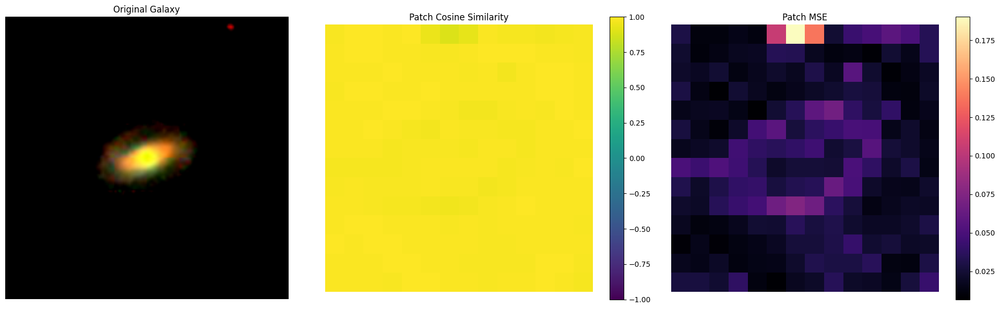

Avg Cosine: 0.9844932
Avg MSE: 0.028376332


In [12]:
model, config = load_jepa_checkpoint(path='/kaggle/input/300jepa/pytorch/default/1/300cosmic_jepa_latest.pth')
visualize_full_latent_map(model, test_subset)

In [116]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import torch.nn.functional as F

def visualize_full_latent_map(model, dataset, device='cuda', idx=32):

    device = torch.device(device if torch.cuda.is_available() else 'cpu')

    model = model.to(device)
    model.eval()

    collator = IJepaMaskCollator(
        input_size=model.config['img_size'],
        patch_size=model.config['patch_size'],
        enc_mask_scale=model.config['context_scale'],
        pred_mask_scale=model.config['mask_scale'],
        num_targets=1
    )

    # 1. fetch sample
    img, _ = dataset[idx]           # CHW tensor
    img = img.to(device)            # <<< FIX #1

    # 2. collate
    images, ctx_mask, tgt_masks = collator([(img.cpu(), 0)])
    # collator returns CPU tensors, move them to CUDA
    images = images.to(device)      # <<< FIX #2
    ctx_mask = ctx_mask.to(device)
    tgt_mask = tgt_masks[0].to(device).bool()

    with torch.no_grad():
        target_emb  = model.forward_target(images)[0]           # (N, C)
        context_emb = model.forward_context(images, ctx_mask)[0]
        pred_emb    = model.forward_predictor(
                            context_emb.unsqueeze(0),
                            [tgt_mask]
                      )[0][0]

    N, C = target_emb.shape
    grid = int(np.sqrt(N))

    # reshape masks
    ctx_mask_img = ctx_mask[0].reshape(grid, grid).cpu().numpy()
    tgt_mask_img = tgt_mask[0].reshape(grid, grid).cpu().numpy()

    # cosine similarity
    pred_norm = F.normalize(pred_emb, dim=-1)
    tgt_norm  = F.normalize(target_emb, dim=-1)
    cos = (pred_norm * tgt_norm).sum(-1).detach().cpu().numpy()

    # mse
    mse = ((pred_emb - target_emb)**2).mean(-1).detach().cpu().numpy()

    cos_map = cos.reshape(grid, grid)
    mse_map = mse.reshape(grid, grid)

    # ===============================================
    # PLOT EVERYTHING
    # ===============================================

    fig, axes = plt.subplots(1, 5, figsize=(28, 6))

    # original galaxy
    axes[0].imshow(img.detach().cpu().permute(1,2,0))
    axes[0].set_title("Original Galaxy")
    axes[0].axis("off")

    axes[1].imshow(ctx_mask_img, cmap='Greens')
    axes[1].set_title("Context Mask (Seen)")
    axes[1].axis("off")

    axes[2].imshow(tgt_mask_img, cmap='Reds')
    axes[2].set_title("Target Mask (Predicted)")
    axes[2].axis("off")

    im1 = axes[3].imshow(cos_map, cmap='viridis', vmin=-1, vmax=1)
    axes[3].set_title("Patch Cosine Similarity")
    axes[3].axis("off")
    fig.colorbar(im1, ax=axes[3])

    im2 = axes[4].imshow(mse_map, cmap='magma')
    axes[4].set_title("Patch MSE")
    axes[4].axis("off")
    fig.colorbar(im2, ax=axes[4])

    plt.tight_layout()
    plt.show()

    print("\nIndex:", idx)
    print("Avg Cosine:", cos.mean())
    print("Avg MSE:", mse.mean())


In [10]:
import torch
import torch.nn.functional as F
import numpy as np
import pandas as pd
from tqdm import tqdm




@torch.no_grad()
def compute_jepa_anomaly_scores(
    model,
    dataset,
    batch_size=64,
    device="cuda",
    save_path=None
):
    """
    Compute per-galaxy anomaly scores using JEPA latent prediction error.

    For each image:
      - use IJepaMaskCollator to sample context & target blocks
      - run target encoder, context encoder, predictor
      - compute cosine similarity and MSE on MASKED patches only
      - aggregate:
          mean_mse, max_mse, mean_cos, min_cos, num_masked_patches
      - combine into a scalar anomaly_score

    Returns:
      df: pandas DataFrame with one row per image in `dataset`.
    """

    device = torch.device(device if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    # masking config from model
    img_size = model.config["img_size"]
    patch_size = model.config["patch_size"]
    context_scale = model.config["context_scale"]
    mask_scale = model.config["mask_scale"]
    num_targets = model.config["num_targets"]
    min_ctx = model.config.get("min_context_patches", 8)

    collator = IJepaMaskCollator(
        input_size=img_size,
        patch_size=patch_size,
        enc_mask_scale=context_scale,
        pred_mask_scale=mask_scale,
        num_targets=num_targets,
        min_context_patches=min_ctx,
    )

    num_samples = len(dataset)

    rows = {
        "index": [],
        "label": [],
        "mean_mse": [],
        "max_mse": [],
        "mean_cos": [],
        "min_cos": [],
        "num_masked_patches": [],
        "anomaly_score": [],
    }

    print(f"Computing anomaly scores on {num_samples} images using {device}.")

    for start in tqdm(range(0, num_samples, batch_size)):
        end = min(start + batch_size, num_samples)

        # manual mini-batch from dataset
        batch_samples = [dataset[i] for i in range(start, end)]
        imgs = [x[0] for x in batch_samples]
        labels = torch.tensor([int(x[1]) for x in batch_samples])

        images, ctx_mask, tgt_masks = collator(
            [(img, lbl) for img, lbl in zip(imgs, labels)]
        )

        images = images.to(device)
        ctx_mask = ctx_mask.to(device)
        tgt_masks = [m.to(device).bool() for m in tgt_masks]

        # forward passes
        target_emb = model.forward_target(images)              # (B, N, C)
        context_emb = model.forward_context(images, ctx_mask)  # (B, N, C)
        preds_list = model.forward_predictor(context_emb, tgt_masks)
        # preds_list: list of length num_targets, each (B, N, C)

        B, N, C = target_emb.shape

        # collect per image
        per_img_cos = [[] for _ in range(B)]
        per_img_mse = [[] for _ in range(B)]

        for pred_block, mask_block in zip(preds_list, tgt_masks):
            # pred_block: (B, N, C), mask_block: (B, N)
            for b in range(B):
                m = mask_block[b]      # (N,)
                if not m.any():
                    continue

                p = pred_block[b][m]   # (#patch, C)
                t = target_emb[b][m]   # (#patch, C)

                # cosine similarity per patch
                cos_vals = F.cosine_similarity(p, t, dim=-1)  # (#patch,)
                # mse per patch (over embedding dim)
                mse_vals = F.mse_loss(p, t, reduction="none").mean(dim=-1)

                per_img_cos[b].append(cos_vals.cpu())
                per_img_mse[b].append(mse_vals.cpu())

        # aggregate stats and anomaly score
        for local_idx in range(B):
            global_idx = start + local_idx
            label = int(labels[local_idx].item())

            if len(per_img_mse[local_idx]) == 0:
                # nothing masked, should not happen but whatever
                mean_mse = float("nan")
                max_mse = float("nan")
                mean_cos = float("nan")
                min_cos = float("nan")
                num_masked = 0
                anomaly = float("nan")
            else:
                mse_all = torch.cat(per_img_mse[local_idx])    # (K,)
                cos_all = torch.cat(per_img_cos[local_idx])    # (K,)

                mean_mse = mse_all.mean().item()
                max_mse = mse_all.max().item()
                mean_cos = cos_all.mean().item()
                min_cos = cos_all.min().item()
                num_masked = mse_all.numel()

                # simple hand tuned anomaly score:
                #   base on mean error, penalize large peaks, reward low cosine
                anomaly = (
                    mean_mse
                    + 0.5 * max_mse
                    + 0.1 * (1.0 - mean_cos)
                )

            rows["index"].append(global_idx)
            rows["label"].append(label)
            rows["mean_mse"].append(mean_mse)
            rows["max_mse"].append(max_mse)
            rows["mean_cos"].append(mean_cos)
            rows["min_cos"].append(min_cos)
            rows["num_masked_patches"].append(num_masked)
            rows["anomaly_score"].append(anomaly)

    df = pd.DataFrame(rows)
    df = df.sort_values("anomaly_score", ascending=False).reset_index(drop=True)

    if save_path is not None:
        df.to_csv(save_path, index=False)
        print(f"Saved anomaly scores to {save_path}")

    return df


In [13]:
device = "cuda"  # or "cpu"

anomaly_df = compute_jepa_anomaly_scores(
    model,
    test_subset,          # or full_dataset
    batch_size=64,
    device=device,
    save_path="galaxy_anomaly_scores.csv"
)

anomaly_df.head()


Computing anomaly scores on 1774 images using cuda.


100%|██████████| 28/28 [00:10<00:00,  2.59it/s]

Saved anomaly scores to galaxy_anomaly_scores.csv


,index,label,mean_mse,max_mse,mean_cos,min_cos,num_masked_patches,anomaly_score
0,344,8,0.121138,1.134584,0.930207,0.338364,36,0.695409
1,1258,8,0.130397,1.057197,0.926283,0.397418,33,0.666367
2,1164,2,0.155420,0.995755,0.911873,0.431544,44,0.662111
3,1712,2,0.204984,0.761708,0.883112,0.563546,25,0.597527
4,1402,2,0.056783,1.049086,0.968186,0.399680,37,0.584508


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



=== Visualizing anomaly at dataset index 344 (score: 0.6954) ===


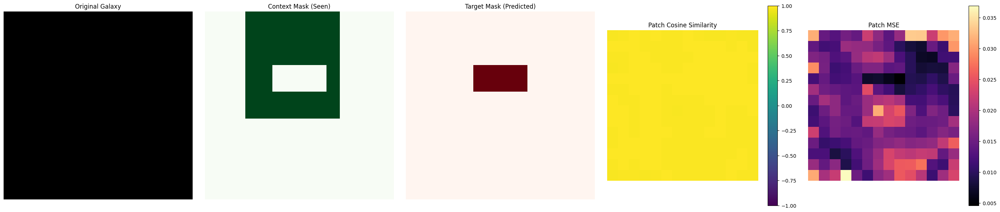

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 344
Avg Cosine: 0.9913973
Avg MSE: 0.01615974

=== Visualizing anomaly at dataset index 1258 (score: 0.6664) ===


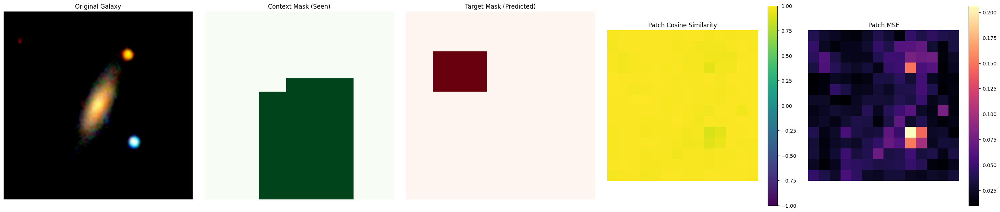

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1258
Avg Cosine: 0.98039365
Avg MSE: 0.03565785

=== Visualizing anomaly at dataset index 1164 (score: 0.6621) ===


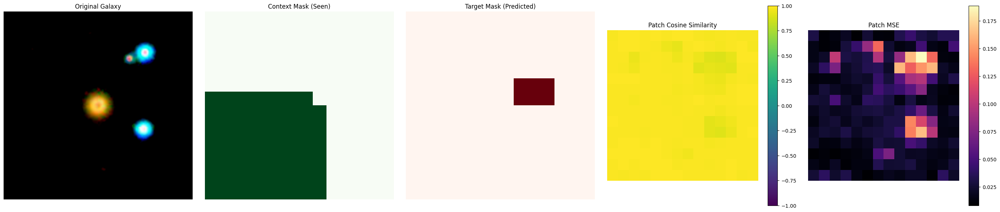

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1164
Avg Cosine: 0.9805624
Avg MSE: 0.03512018

=== Visualizing anomaly at dataset index 1712 (score: 0.5975) ===


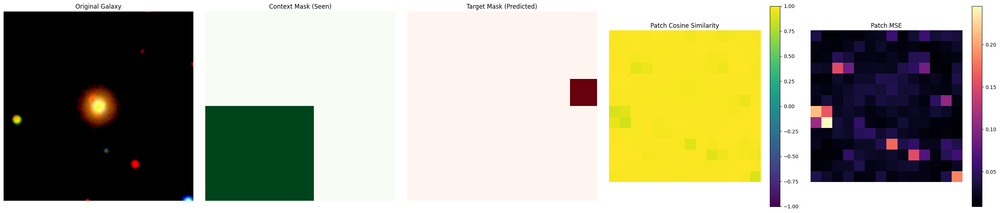

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1712
Avg Cosine: 0.9820121
Avg MSE: 0.032696705

=== Visualizing anomaly at dataset index 1402 (score: 0.5845) ===


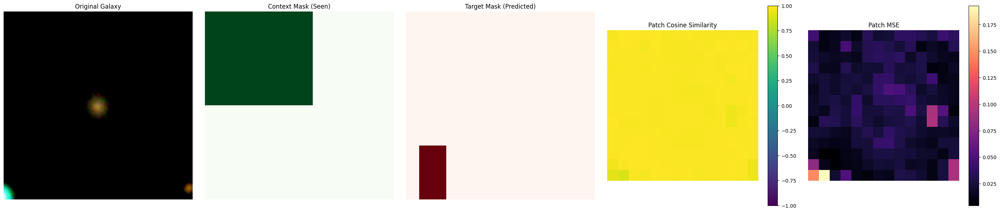

Random galaxy index: 1402
Avg Cosine: 0.985004
Avg MSE: 0.027458789

=== Visualizing anomaly at dataset index 1503 (score: 0.5527) ===


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


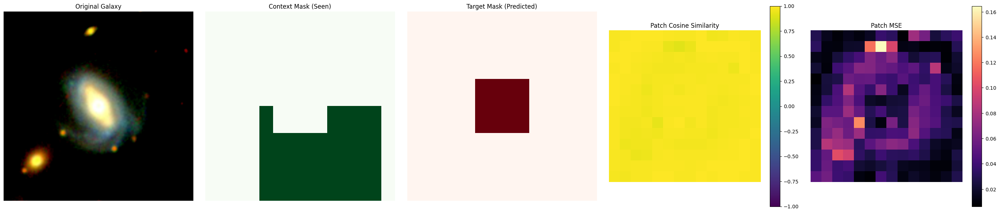

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1503
Avg Cosine: 0.97907335
Avg MSE: 0.03786797

=== Visualizing anomaly at dataset index 492 (score: 0.5308) ===


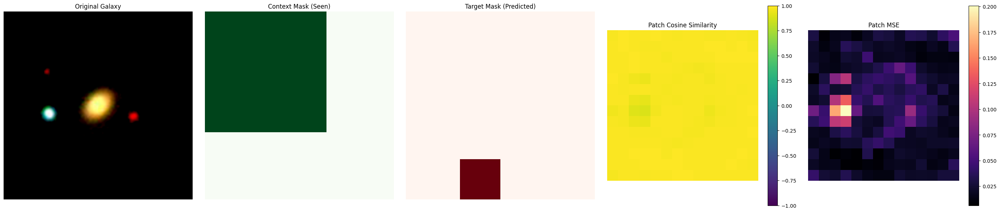

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 492
Avg Cosine: 0.9834196
Avg MSE: 0.030175032

=== Visualizing anomaly at dataset index 565 (score: 0.5090) ===


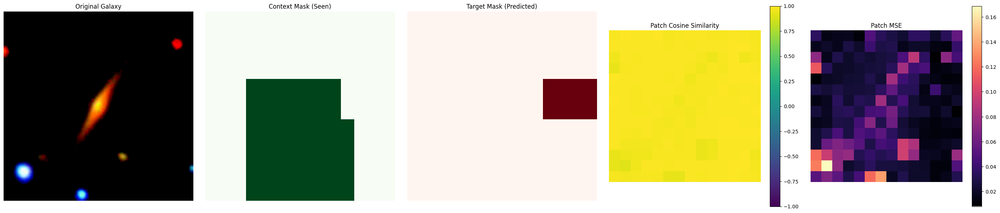

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 565
Avg Cosine: 0.98076725
Avg MSE: 0.035022262

=== Visualizing anomaly at dataset index 846 (score: 0.5058) ===


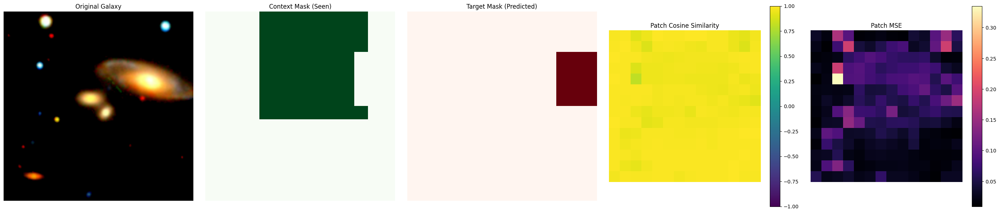

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 846
Avg Cosine: 0.97035575
Avg MSE: 0.053118296

=== Visualizing anomaly at dataset index 523 (score: 0.4906) ===


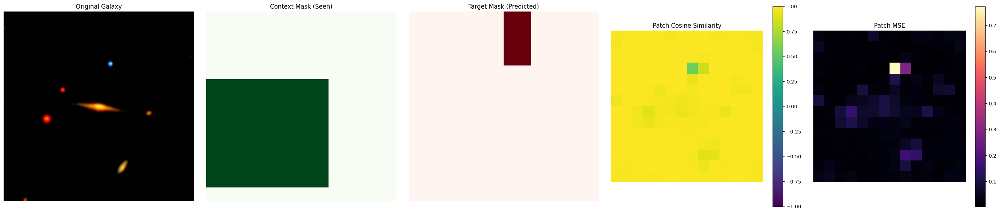

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 523
Avg Cosine: 0.9806665
Avg MSE: 0.03498744

=== Visualizing anomaly at dataset index 1293 (score: 0.4802) ===


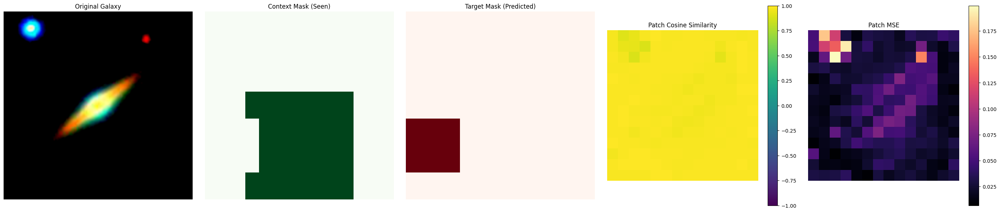

Random galaxy index: 1293
Avg Cosine: 0.980368
Avg MSE: 0.035699405

=== Visualizing anomaly at dataset index 1299 (score: 0.4734) ===


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


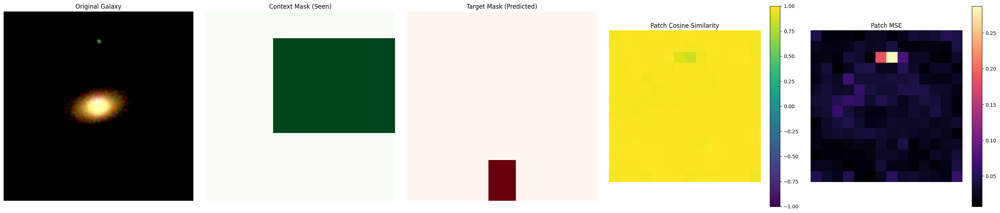

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1299
Avg Cosine: 0.983667
Avg MSE: 0.029818704

=== Visualizing anomaly at dataset index 1677 (score: 0.4718) ===


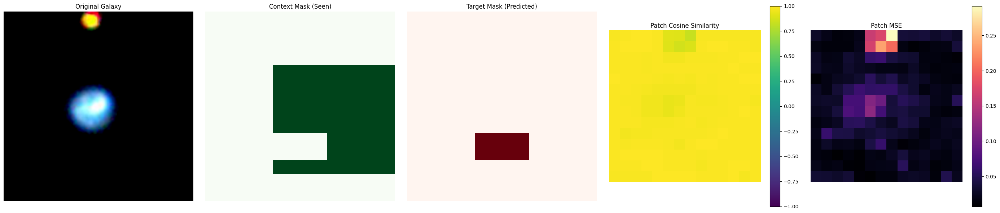

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1677
Avg Cosine: 0.9809657
Avg MSE: 0.034449566

=== Visualizing anomaly at dataset index 624 (score: 0.4674) ===


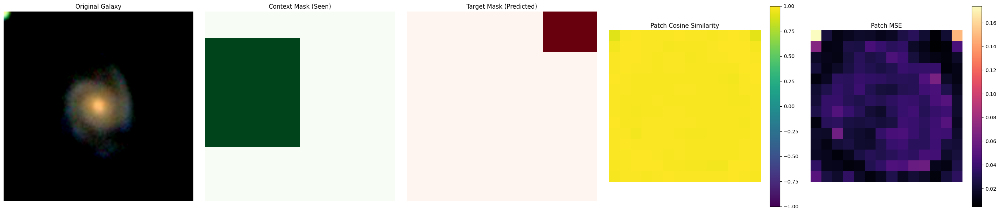

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 624
Avg Cosine: 0.9841342
Avg MSE: 0.029082274

=== Visualizing anomaly at dataset index 277 (score: 0.4556) ===


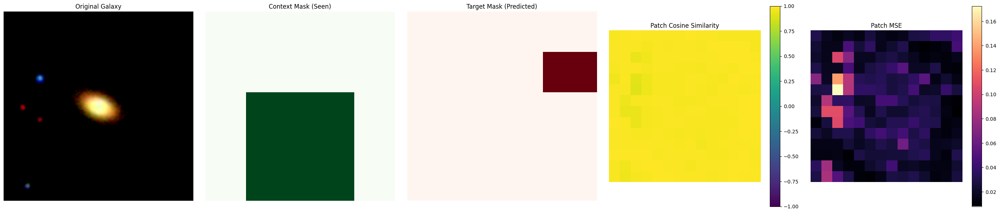

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 277
Avg Cosine: 0.9834031
Avg MSE: 0.030292064

=== Visualizing anomaly at dataset index 1757 (score: 0.4530) ===


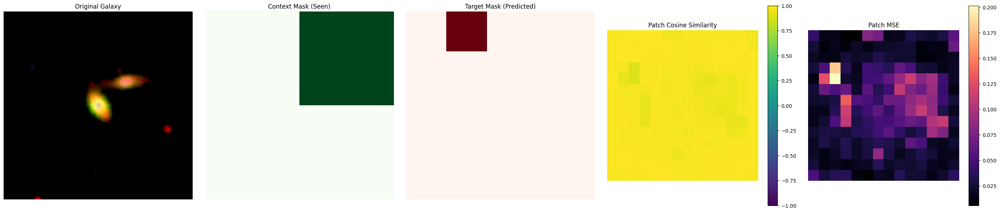

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1757
Avg Cosine: 0.97786987
Avg MSE: 0.03989673

=== Visualizing anomaly at dataset index 1036 (score: 0.4527) ===


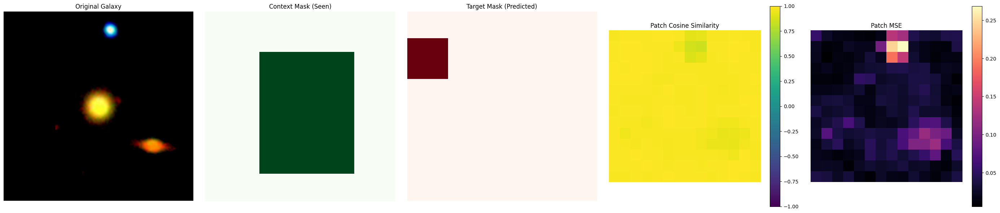

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1036
Avg Cosine: 0.9801971
Avg MSE: 0.035875157

=== Visualizing anomaly at dataset index 1334 (score: 0.4519) ===


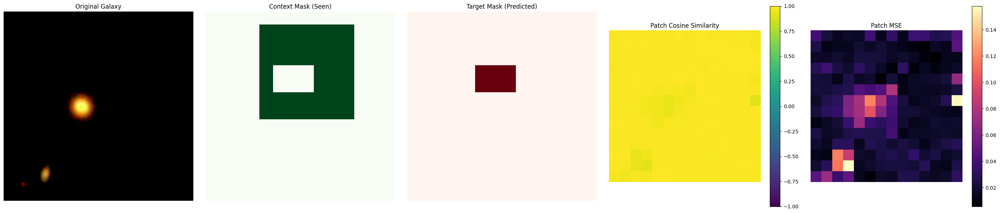

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1334
Avg Cosine: 0.9847654
Avg MSE: 0.027856633

=== Visualizing anomaly at dataset index 1273 (score: 0.4500) ===


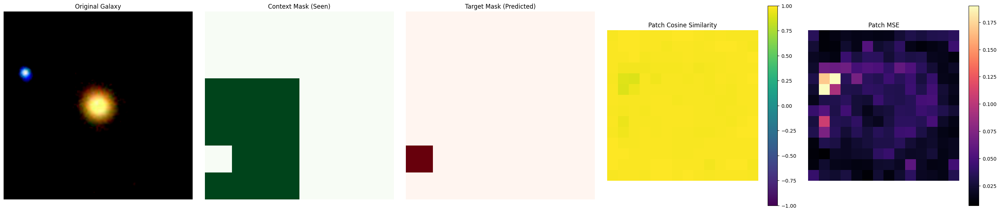

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1273
Avg Cosine: 0.9824613
Avg MSE: 0.031956546

=== Visualizing anomaly at dataset index 1705 (score: 0.4452) ===


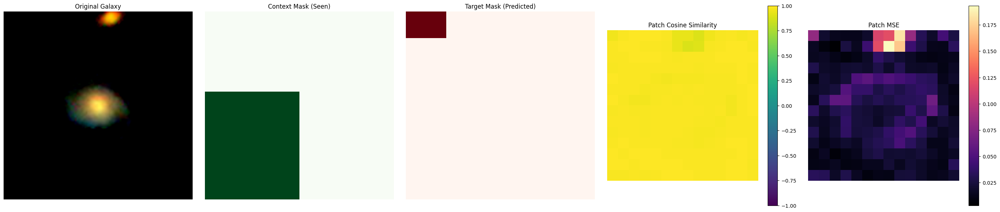

Random galaxy index: 1705
Avg Cosine: 0.98444086
Avg MSE: 0.028438916


In [24]:
# Take top-k anomalies
top_k = anomaly_df.head(20)

for _, row in top_k.iterrows():
    idx = int(row["index"])
    print(f"\n=== Visualizing anomaly at dataset index {idx} (score: {row['anomaly_score']:.4f}) ===")
    visualize_full_latent_map(model, test_subset, device='cuda', idx=idx)


In [27]:
import os

os.makedirs("anomaly_gallery", exist_ok=True)
def save_anomaly_report(model, dataset, idx, score, save_path, device='cuda'):
    plt.figure(figsize=(24, 6))

    # Run your visualization function
    model.eval()
    visualize_full_latent_map(model, dataset, idx=idx, device=device)

    # Save
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    plt.close()

    print(f"Saved report: {save_path}")


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<Figure size 2400x600 with 0 Axes>

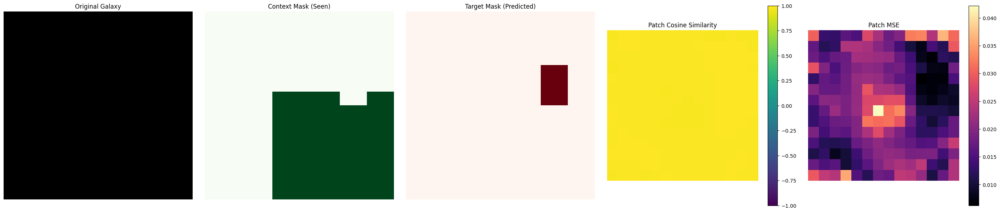

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 344
Avg Cosine: 0.9902249
Avg MSE: 0.018246148
Saved report: anomaly_gallery/anomaly_344_score_0.695.png


<Figure size 2400x600 with 0 Axes>

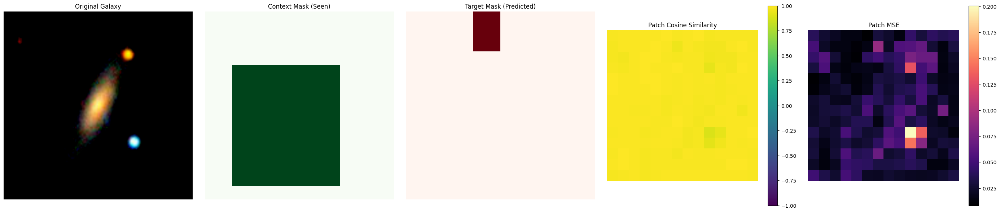

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1258
Avg Cosine: 0.9814547
Avg MSE: 0.033809166
Saved report: anomaly_gallery/anomaly_1258_score_0.666.png


<Figure size 2400x600 with 0 Axes>

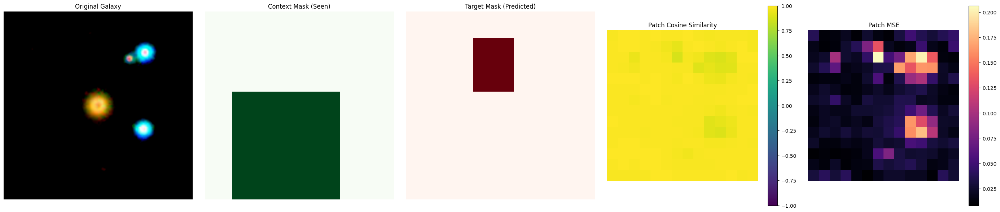

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1164
Avg Cosine: 0.9795738
Avg MSE: 0.036842596
Saved report: anomaly_gallery/anomaly_1164_score_0.662.png


<Figure size 2400x600 with 0 Axes>

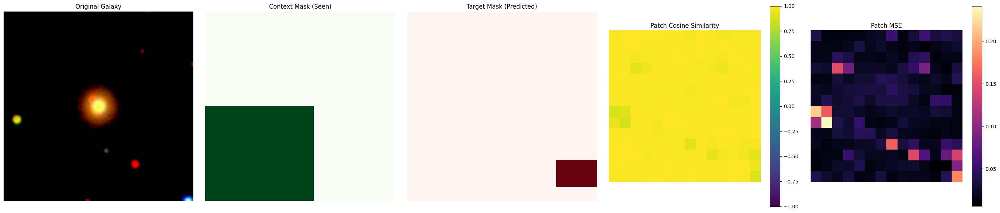

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1712
Avg Cosine: 0.9823473
Avg MSE: 0.03208846
Saved report: anomaly_gallery/anomaly_1712_score_0.598.png


<Figure size 2400x600 with 0 Axes>

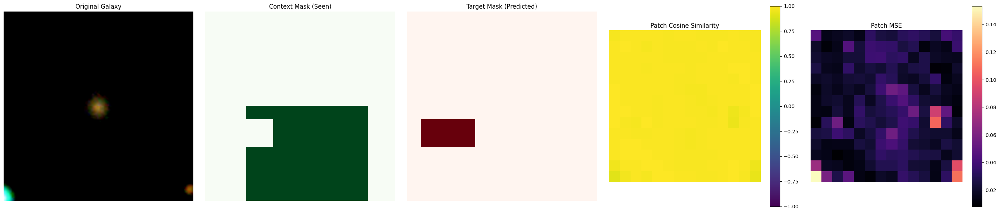

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1402
Avg Cosine: 0.98506445
Avg MSE: 0.02737252
Saved report: anomaly_gallery/anomaly_1402_score_0.585.png


<Figure size 2400x600 with 0 Axes>

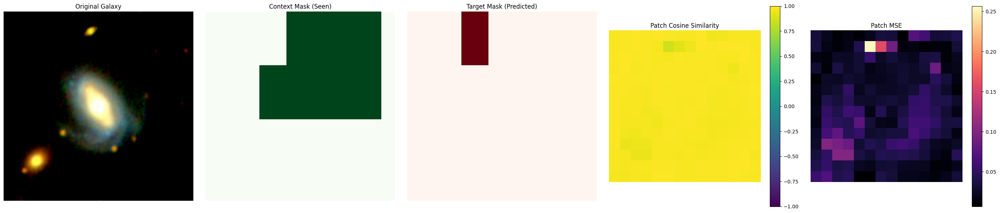

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1503
Avg Cosine: 0.9801626
Avg MSE: 0.036049623
Saved report: anomaly_gallery/anomaly_1503_score_0.553.png


<Figure size 2400x600 with 0 Axes>

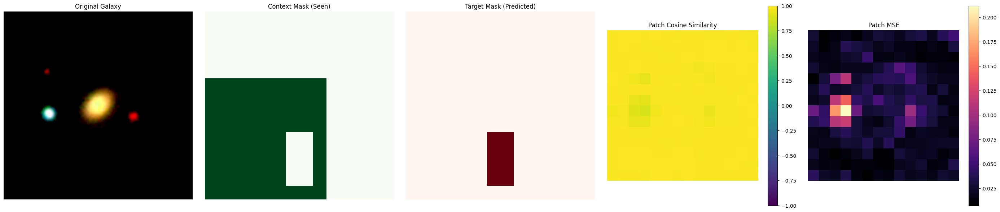

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 492
Avg Cosine: 0.9838903
Avg MSE: 0.029333558
Saved report: anomaly_gallery/anomaly_492_score_0.531.png


<Figure size 2400x600 with 0 Axes>

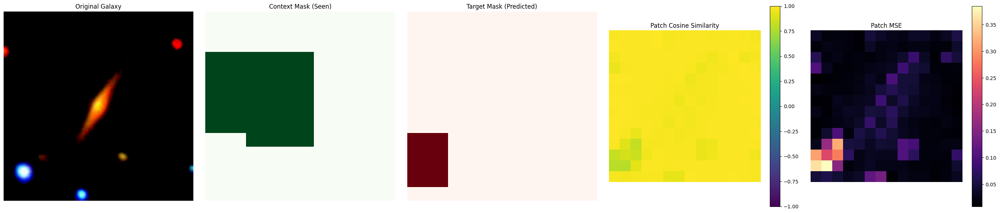

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 565
Avg Cosine: 0.97624034
Avg MSE: 0.0430006
Saved report: anomaly_gallery/anomaly_565_score_0.509.png


<Figure size 2400x600 with 0 Axes>

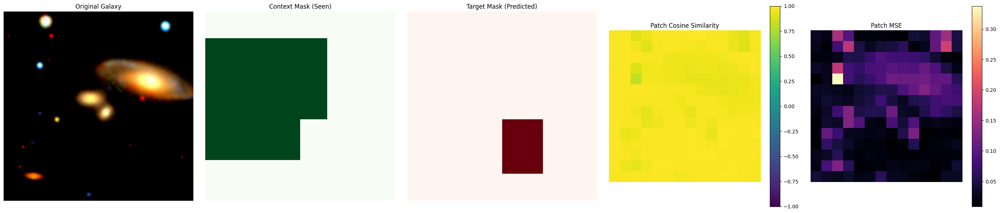

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 846
Avg Cosine: 0.97122425
Avg MSE: 0.0515186
Saved report: anomaly_gallery/anomaly_846_score_0.506.png


<Figure size 2400x600 with 0 Axes>

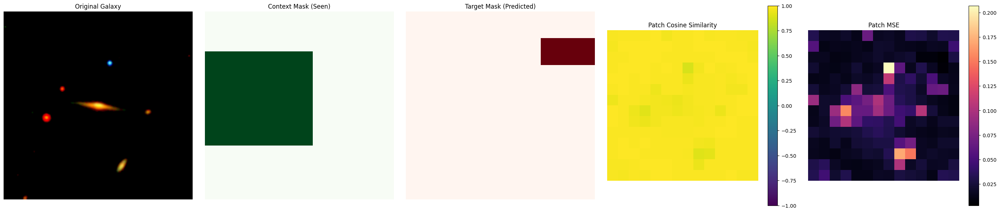

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 523
Avg Cosine: 0.9830414
Avg MSE: 0.030840402
Saved report: anomaly_gallery/anomaly_523_score_0.491.png


<Figure size 2400x600 with 0 Axes>

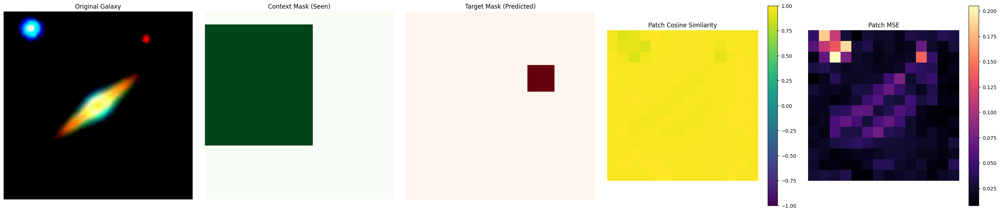

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1293
Avg Cosine: 0.98191214
Avg MSE: 0.032985613
Saved report: anomaly_gallery/anomaly_1293_score_0.480.png


<Figure size 2400x600 with 0 Axes>

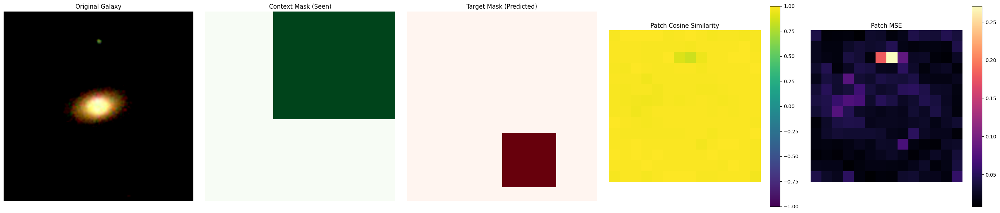

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1299
Avg Cosine: 0.9832633
Avg MSE: 0.030511763
Saved report: anomaly_gallery/anomaly_1299_score_0.473.png


<Figure size 2400x600 with 0 Axes>

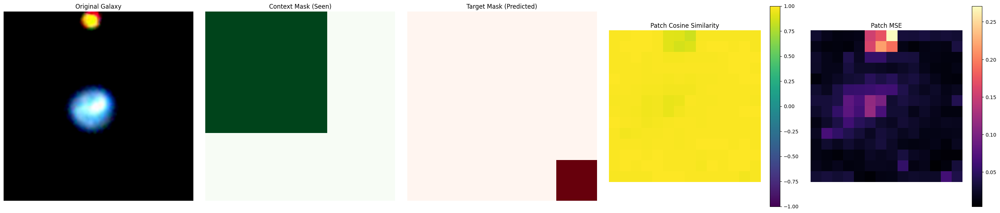

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1677
Avg Cosine: 0.9819414
Avg MSE: 0.032768562
Saved report: anomaly_gallery/anomaly_1677_score_0.472.png


<Figure size 2400x600 with 0 Axes>

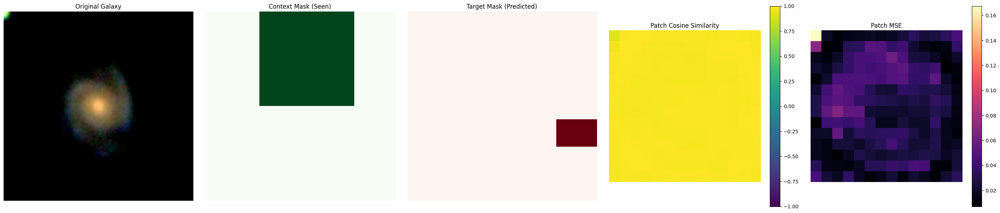

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 624
Avg Cosine: 0.98420966
Avg MSE: 0.028953448
Saved report: anomaly_gallery/anomaly_624_score_0.467.png


<Figure size 2400x600 with 0 Axes>

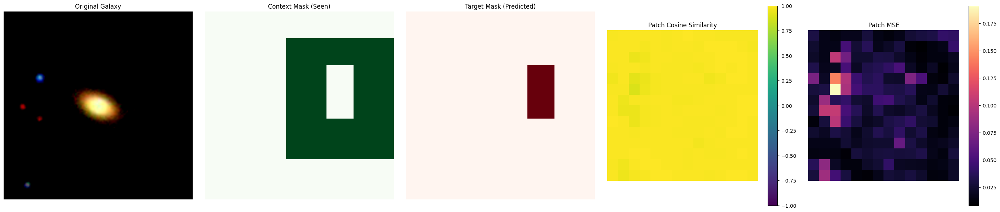

Random galaxy index: 277
Avg Cosine: 0.9832898
Avg MSE: 0.030475598
Saved report: anomaly_gallery/anomaly_277_score_0.456.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<Figure size 2400x600 with 0 Axes>

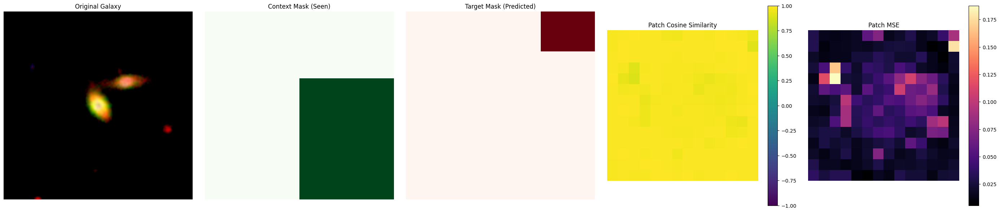

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1757
Avg Cosine: 0.98066974
Avg MSE: 0.035037864
Saved report: anomaly_gallery/anomaly_1757_score_0.453.png


<Figure size 2400x600 with 0 Axes>

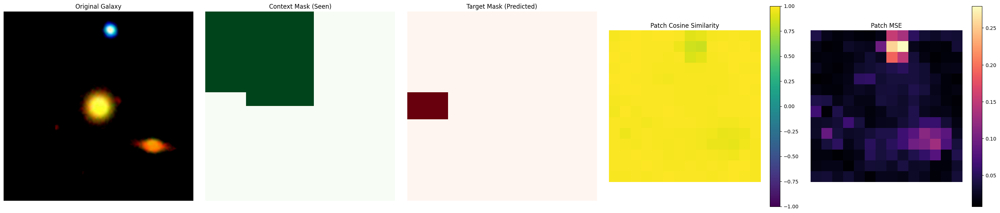

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1036
Avg Cosine: 0.97963417
Avg MSE: 0.03686927
Saved report: anomaly_gallery/anomaly_1036_score_0.453.png


<Figure size 2400x600 with 0 Axes>

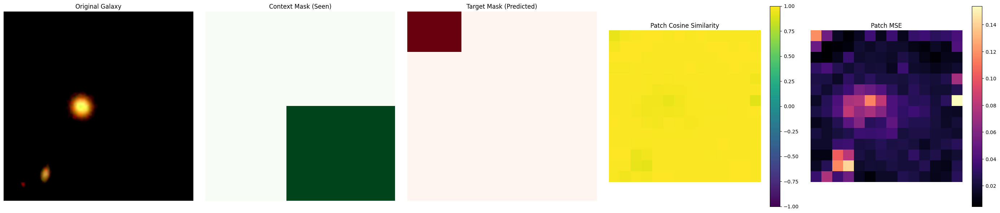

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1334
Avg Cosine: 0.98390853
Avg MSE: 0.029377582
Saved report: anomaly_gallery/anomaly_1334_score_0.452.png


<Figure size 2400x600 with 0 Axes>

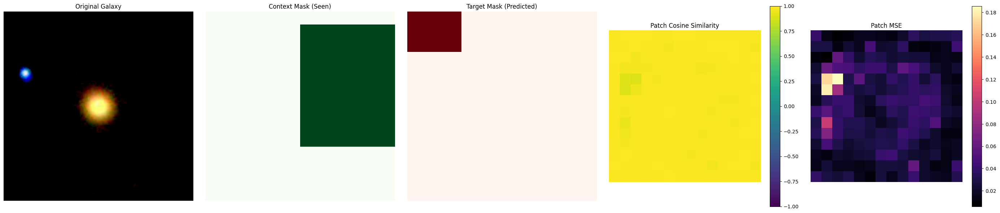

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1273
Avg Cosine: 0.98300296
Avg MSE: 0.031037174
Saved report: anomaly_gallery/anomaly_1273_score_0.450.png


<Figure size 2400x600 with 0 Axes>

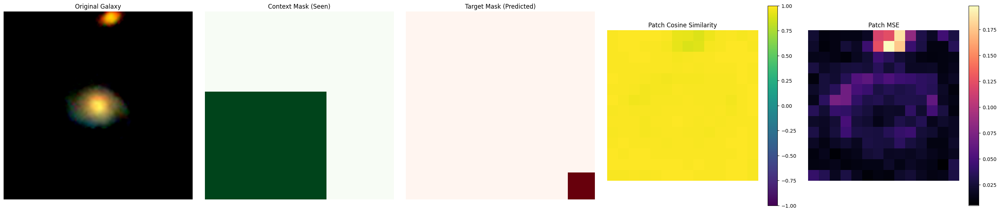

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1705
Avg Cosine: 0.984114
Avg MSE: 0.02898838
Saved report: anomaly_gallery/anomaly_1705_score_0.445.png


<Figure size 2400x600 with 0 Axes>

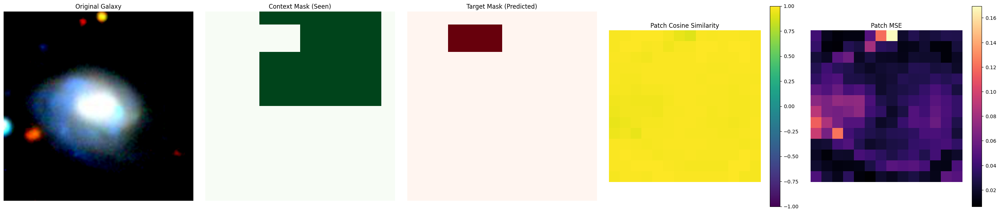

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 385
Avg Cosine: 0.9805325
Avg MSE: 0.035529252
Saved report: anomaly_gallery/anomaly_385_score_0.445.png


<Figure size 2400x600 with 0 Axes>

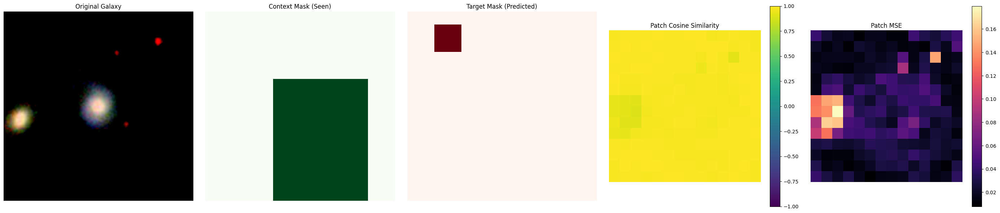

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1031
Avg Cosine: 0.98127604
Avg MSE: 0.033964425
Saved report: anomaly_gallery/anomaly_1031_score_0.442.png


<Figure size 2400x600 with 0 Axes>

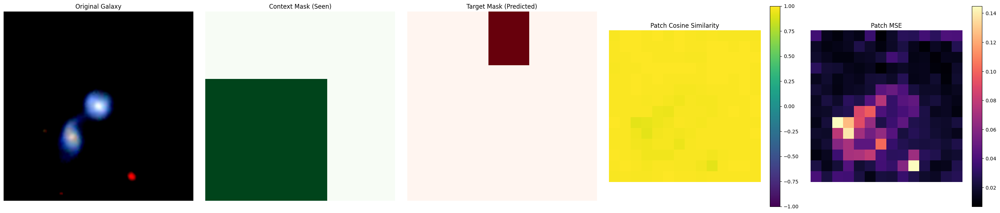

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 921
Avg Cosine: 0.9839394
Avg MSE: 0.029319325
Saved report: anomaly_gallery/anomaly_921_score_0.440.png


<Figure size 2400x600 with 0 Axes>

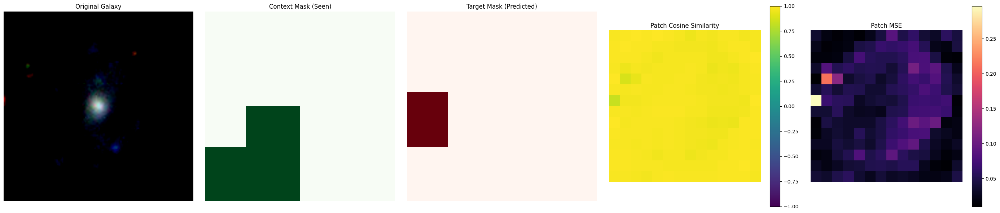

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1408
Avg Cosine: 0.9734972
Avg MSE: 0.047716238
Saved report: anomaly_gallery/anomaly_1408_score_0.433.png


<Figure size 2400x600 with 0 Axes>

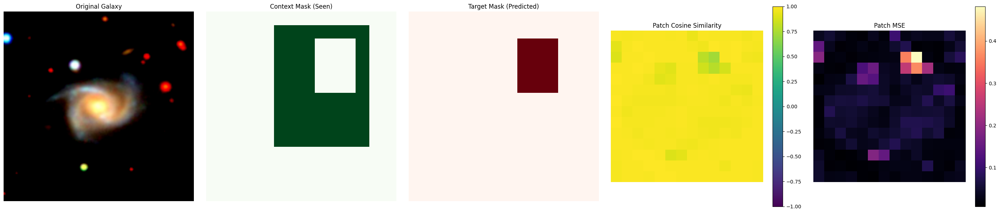

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 61
Avg Cosine: 0.97293144
Avg MSE: 0.04859022
Saved report: anomaly_gallery/anomaly_61_score_0.423.png


<Figure size 2400x600 with 0 Axes>

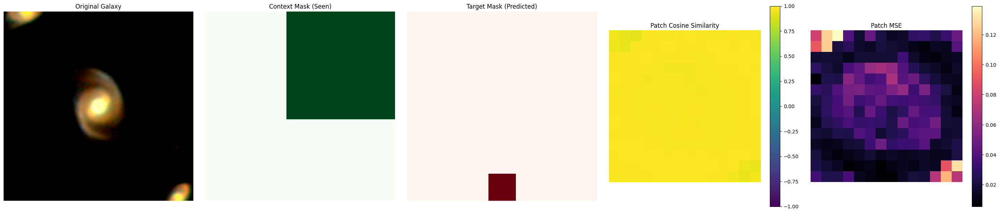

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 609
Avg Cosine: 0.98353916
Avg MSE: 0.030033626
Saved report: anomaly_gallery/anomaly_609_score_0.421.png


<Figure size 2400x600 with 0 Axes>

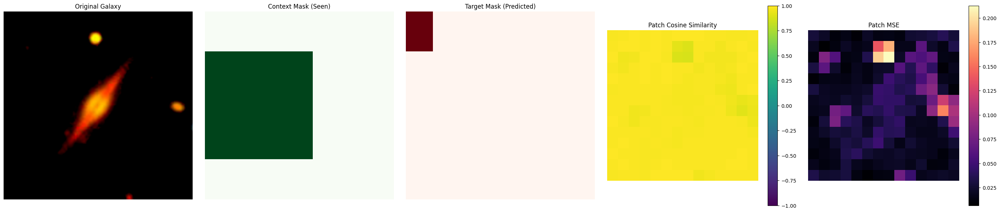

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1127
Avg Cosine: 0.98142743
Avg MSE: 0.033781856
Saved report: anomaly_gallery/anomaly_1127_score_0.420.png


<Figure size 2400x600 with 0 Axes>

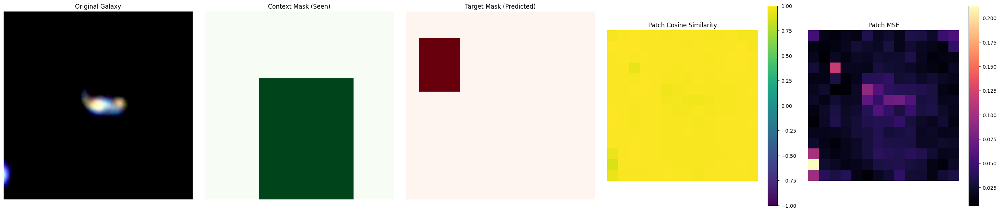

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 987
Avg Cosine: 0.98456883
Avg MSE: 0.028242875
Saved report: anomaly_gallery/anomaly_987_score_0.413.png


<Figure size 2400x600 with 0 Axes>

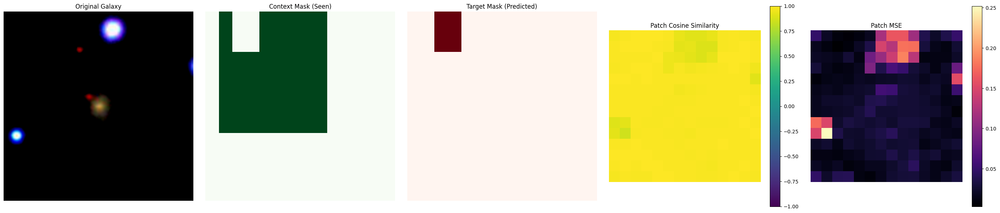

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1291
Avg Cosine: 0.98011345
Avg MSE: 0.03594709
Saved report: anomaly_gallery/anomaly_1291_score_0.399.png


<Figure size 2400x600 with 0 Axes>

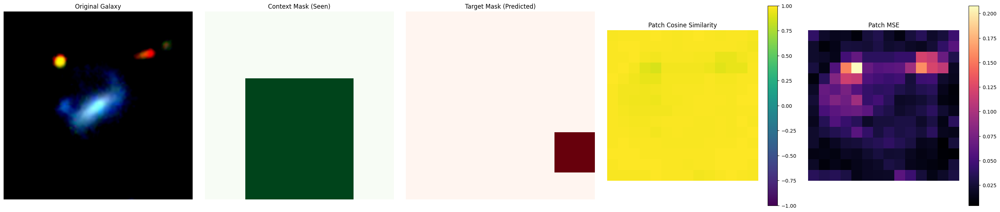

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 818
Avg Cosine: 0.9801519
Avg MSE: 0.03596511
Saved report: anomaly_gallery/anomaly_818_score_0.398.png


<Figure size 2400x600 with 0 Axes>

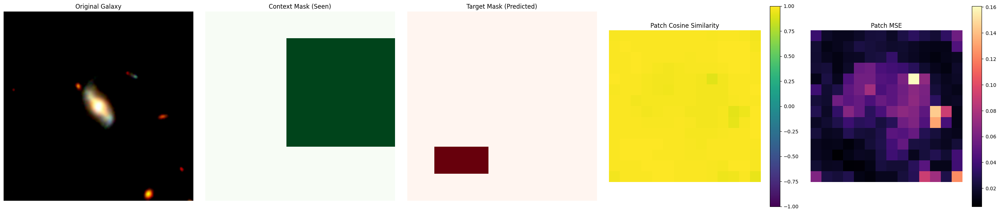

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 213
Avg Cosine: 0.9823069
Avg MSE: 0.032162074
Saved report: anomaly_gallery/anomaly_213_score_0.391.png


<Figure size 2400x600 with 0 Axes>

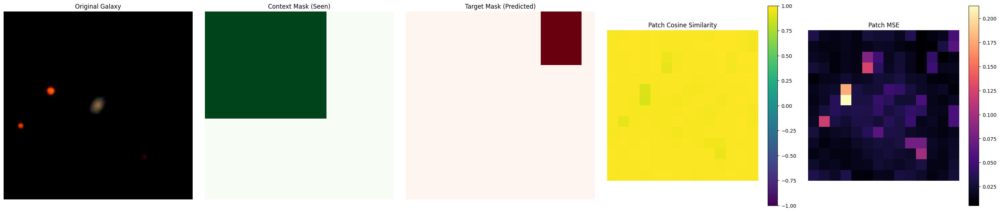

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 229
Avg Cosine: 0.98521763
Avg MSE: 0.027045712
Saved report: anomaly_gallery/anomaly_229_score_0.388.png


<Figure size 2400x600 with 0 Axes>

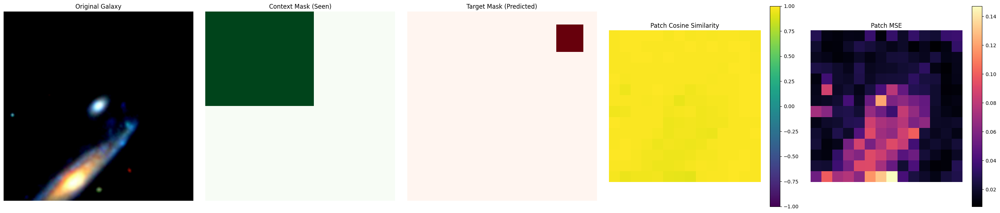

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1684
Avg Cosine: 0.9806363
Avg MSE: 0.03511277
Saved report: anomaly_gallery/anomaly_1684_score_0.385.png


<Figure size 2400x600 with 0 Axes>

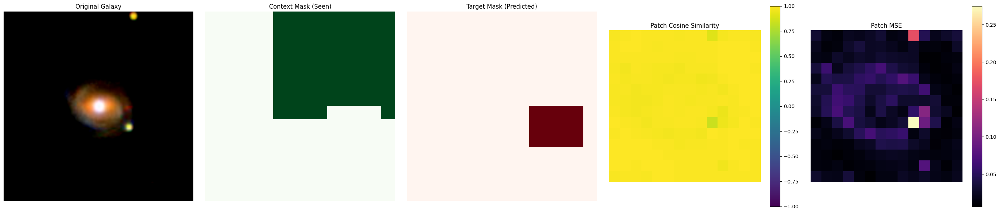

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1346
Avg Cosine: 0.9832807
Avg MSE: 0.030463092
Saved report: anomaly_gallery/anomaly_1346_score_0.384.png


<Figure size 2400x600 with 0 Axes>

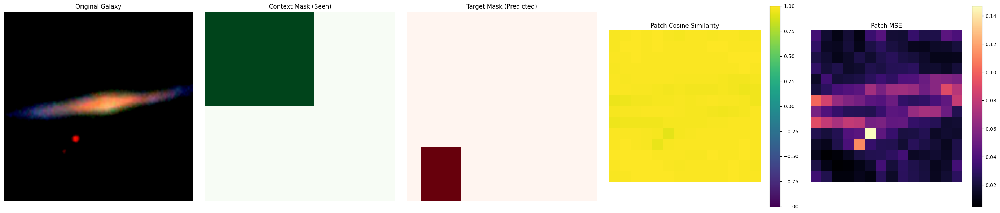

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 933
Avg Cosine: 0.98247784
Avg MSE: 0.03193047
Saved report: anomaly_gallery/anomaly_933_score_0.383.png


<Figure size 2400x600 with 0 Axes>

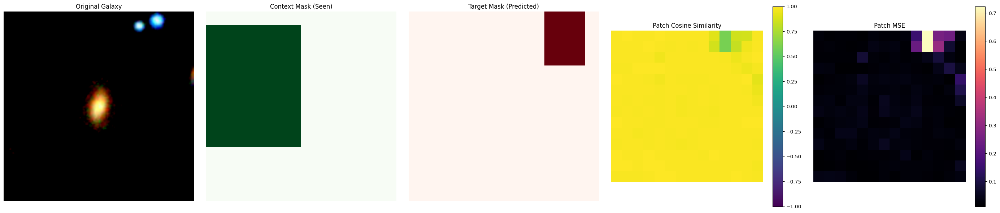

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 259
Avg Cosine: 0.9777772
Avg MSE: 0.040170737
Saved report: anomaly_gallery/anomaly_259_score_0.382.png


<Figure size 2400x600 with 0 Axes>

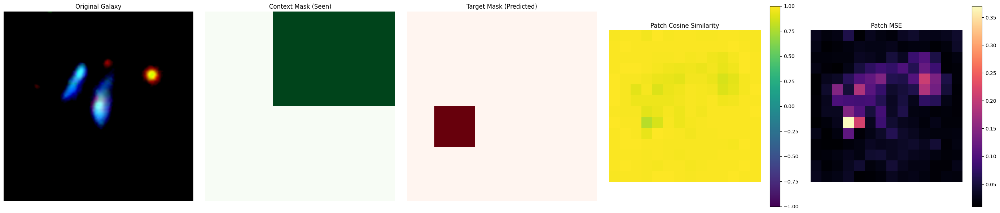

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1426
Avg Cosine: 0.9759514
Avg MSE: 0.043178547
Saved report: anomaly_gallery/anomaly_1426_score_0.381.png


<Figure size 2400x600 with 0 Axes>

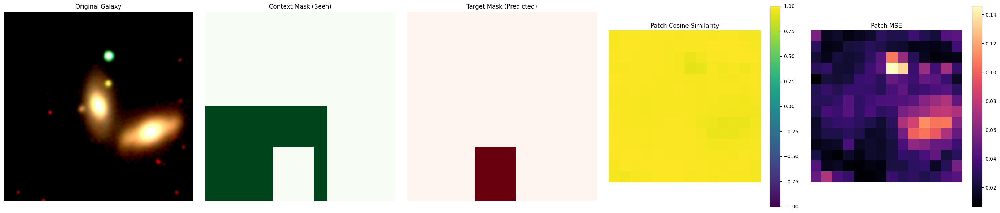

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1616
Avg Cosine: 0.9801033
Avg MSE: 0.03609578
Saved report: anomaly_gallery/anomaly_1616_score_0.377.png


<Figure size 2400x600 with 0 Axes>

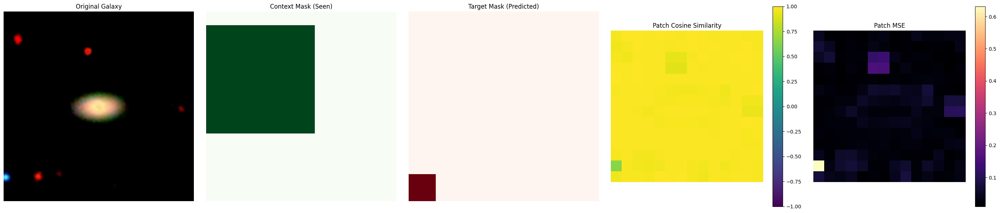

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1085
Avg Cosine: 0.98066527
Avg MSE: 0.035118066
Saved report: anomaly_gallery/anomaly_1085_score_0.376.png


<Figure size 2400x600 with 0 Axes>

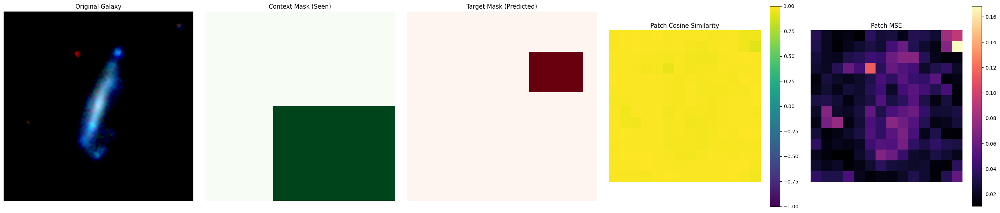

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1192
Avg Cosine: 0.9816012
Avg MSE: 0.033547
Saved report: anomaly_gallery/anomaly_1192_score_0.376.png


<Figure size 2400x600 with 0 Axes>

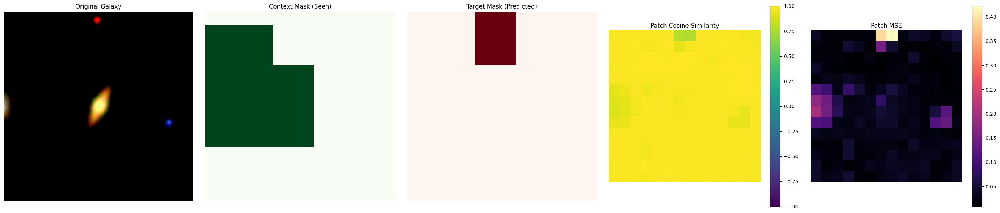

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 390
Avg Cosine: 0.97982126
Avg MSE: 0.03652503
Saved report: anomaly_gallery/anomaly_390_score_0.374.png


<Figure size 2400x600 with 0 Axes>

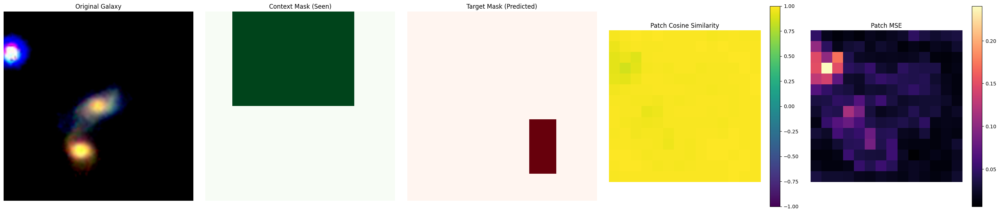

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 415
Avg Cosine: 0.980216
Avg MSE: 0.035915975
Saved report: anomaly_gallery/anomaly_415_score_0.374.png


<Figure size 2400x600 with 0 Axes>

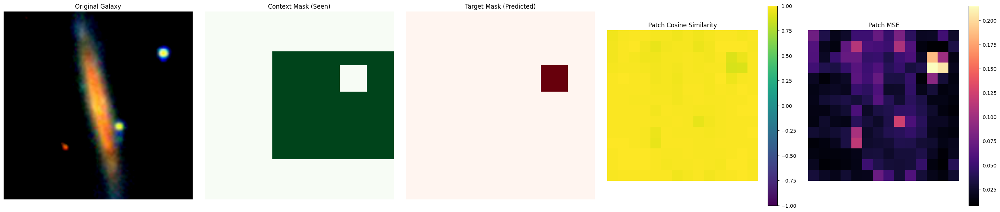

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 488
Avg Cosine: 0.9793012
Avg MSE: 0.03759472
Saved report: anomaly_gallery/anomaly_488_score_0.366.png


<Figure size 2400x600 with 0 Axes>

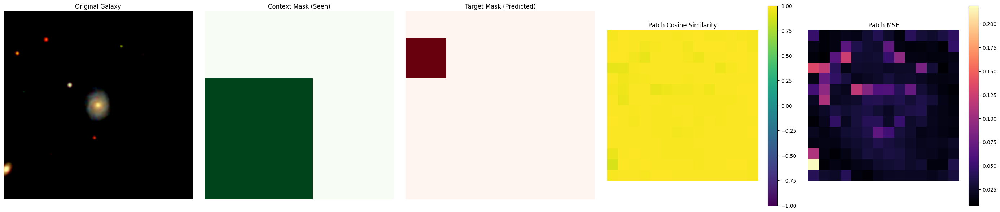

Random galaxy index: 798
Avg Cosine: 0.9827395
Avg MSE: 0.031450223
Saved report: anomaly_gallery/anomaly_798_score_0.364.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<Figure size 2400x600 with 0 Axes>

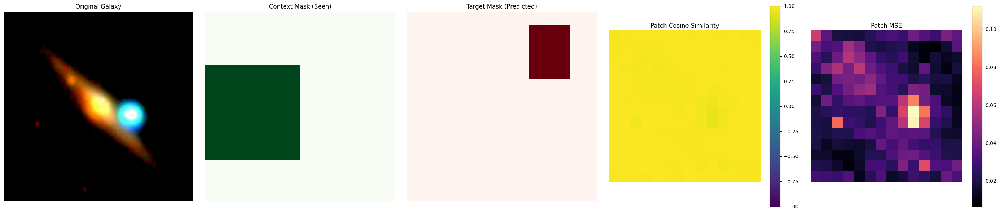

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 756
Avg Cosine: 0.98365766
Avg MSE: 0.029976163
Saved report: anomaly_gallery/anomaly_756_score_0.364.png


<Figure size 2400x600 with 0 Axes>

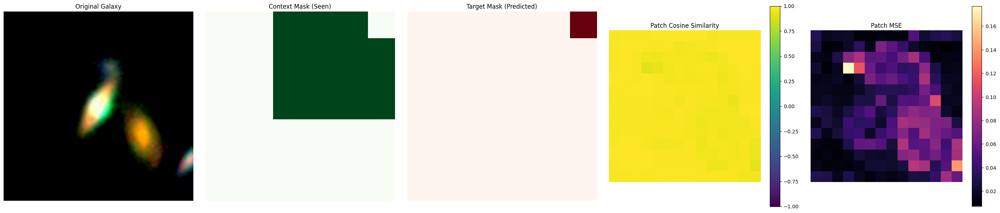

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 665
Avg Cosine: 0.97912145
Avg MSE: 0.037819404
Saved report: anomaly_gallery/anomaly_665_score_0.361.png


<Figure size 2400x600 with 0 Axes>

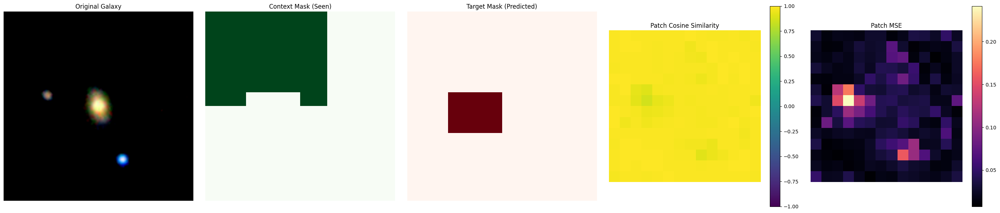

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 554
Avg Cosine: 0.9809001
Avg MSE: 0.03458057
Saved report: anomaly_gallery/anomaly_554_score_0.359.png


<Figure size 2400x600 with 0 Axes>

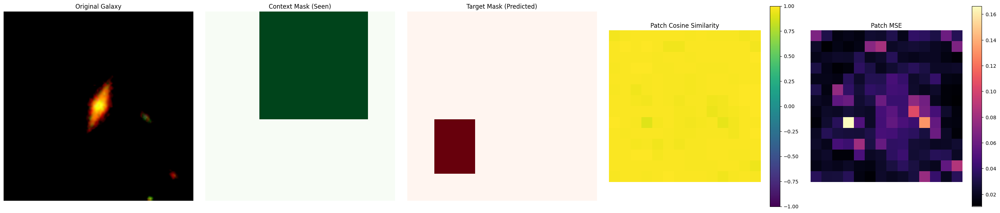

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 83
Avg Cosine: 0.9823781
Avg MSE: 0.032120526
Saved report: anomaly_gallery/anomaly_83_score_0.357.png


<Figure size 2400x600 with 0 Axes>

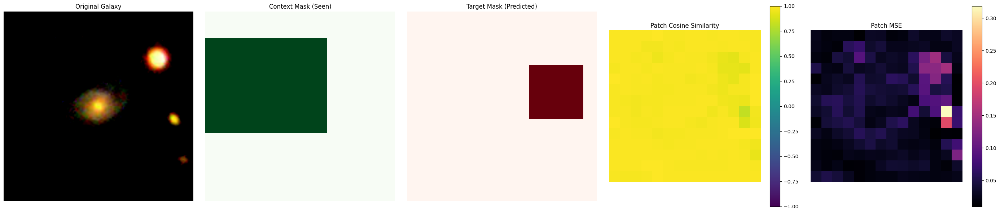

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 743
Avg Cosine: 0.9775408
Avg MSE: 0.040569875
Saved report: anomaly_gallery/anomaly_743_score_0.352.png


<Figure size 2400x600 with 0 Axes>

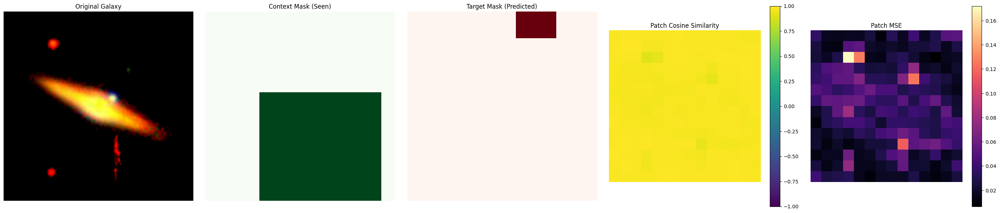

Random galaxy index: 115
Avg Cosine: 0.9814008
Avg MSE: 0.033890896
Saved report: anomaly_gallery/anomaly_115_score_0.350.png


In [28]:
top_k = anomaly_df.sort_values("anomaly_score", ascending=False).head(50)

for i, row in top_k.iterrows():
    idx = int(row["index"])
    score = float(row["anomaly_score"])

    save_path = f"anomaly_gallery/anomaly_{idx}_score_{score:.3f}.png"
    save_anomaly_report(model, test_subset, idx, score, save_path, device='cuda')


In [59]:
!pip install "scikit-learn<1.6"

In [60]:
import torch
from torch.utils.data import DataLoader
import numpy as np
from tqdm import tqdm
import umap

def extract_latents(model, dataset, device='cuda', batch_size=64):
    """
    Extracts latents from a model and dataset.
    """
    # specific check to avoid cuda errors if user forgot to check availability
    device = torch.device(device if torch.cuda.is_available() else 'cpu')
    
    model.to(device)
    model.eval()
    
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    latents = []
    labels = []

    with torch.no_grad():
        for imgs, lbls in tqdm(loader, desc="Extracting Latents"):
            imgs = imgs.to(device)
            
            # Assuming model.forward_target exists as per your snippet
            z = model.forward_target(imgs)   # (B, N, C)
            z = z.mean(dim=1)                # pooled representation (B, C)
            
            latents.append(z.cpu().numpy())
            labels.append(lbls.numpy())

    latents = np.concatenate(latents, axis=0)
    labels = np.concatenate(labels, axis=0)

    # CRITICAL FIX: Cast to float32 HERE, before returning. 
    # This prevents memory bloat and ensures compatibility with UMAP immediately.
    latents = latents.astype(np.float32)

    return latents, labels



In [68]:

latents, labels = extract_latents(model, test_subset)


Extracting Latents: 100%|██████████| 28/28 [00:03<00:00,  7.36it/s]


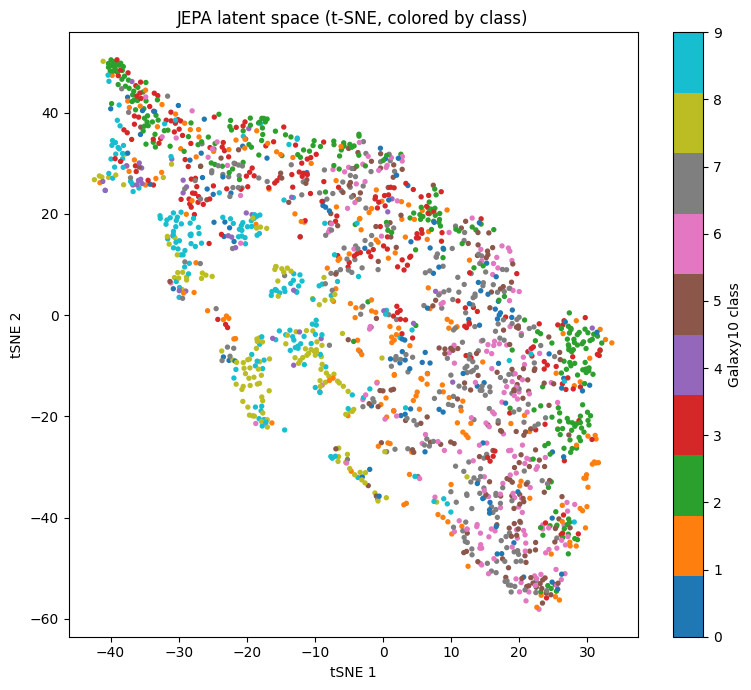

In [69]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

X = latents.astype(np.float32)

tsne = TSNE(
    n_components=2,
    perplexity=30,
    learning_rate=200,
    n_iter=1000,
    metric='cosine',
    random_state=42,
    init='random'
)

embedding_tsne = tsne.fit_transform(X)

plt.figure(figsize=(8, 7))
sc = plt.scatter(
    embedding_tsne[:, 0],
    embedding_tsne[:, 1],
    c=labels,
    s=8,
    cmap='tab10'
)
plt.colorbar(sc, label='Galaxy10 class')
plt.title('JEPA latent space (t-SNE, colored by class)')
plt.xlabel('tSNE 1')
plt.ylabel('tSNE 2')
plt.tight_layout()
plt.show()


In [70]:
# anomaly_df has a column "index" which is dataset index
# sort back by that to match latent order
aligned = anomaly_df.sort_values("index")

anomaly_scores = aligned["anomaly_score"].to_numpy().astype(np.float32)

# sanity check
print(latents.shape[0], anomaly_scores.shape[0])


1774 1774


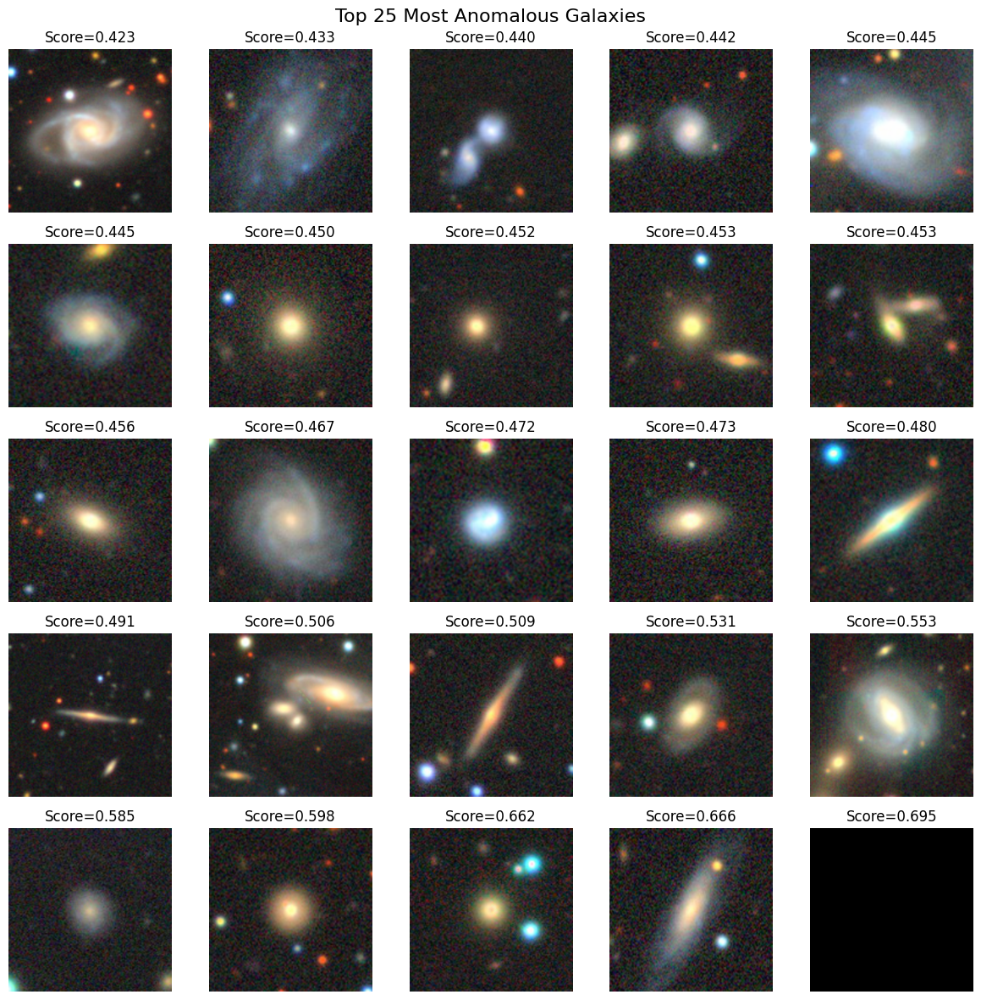

In [86]:
import matplotlib.pyplot as plt

# pick top K anomaly samples
K = 25
top_idx = np.argsort(anomaly_scores)[-K:]

rows, cols = 5, 5
plt.figure(figsize=(12,12))

for i, idx in enumerate(top_idx):
    img, _ = test_subset[idx]
    img_np = img.permute(1,2,0).numpy()
    img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min() + 1e-6)

    plt.subplot(rows, cols, i+1)
    plt.imshow(img_np)
    plt.title(f"Score={anomaly_scores[idx]:.3f}")
    plt.axis("off")

plt.suptitle("Top 25 Most Anomalous Galaxies", fontsize=16)
plt.tight_layout()
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



=== Visualizing anomaly at index 61 ===


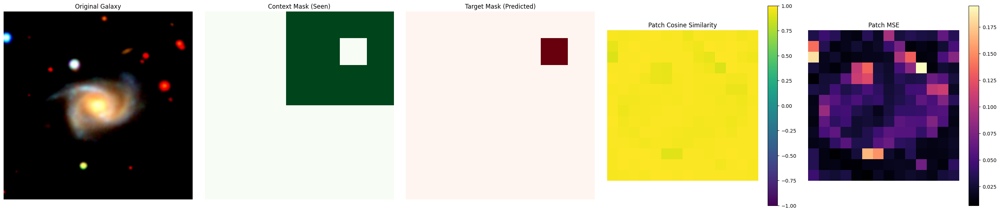

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 61
Avg Cosine: 0.9780983
Avg MSE: 0.039601225

=== Visualizing anomaly at index 1408 ===


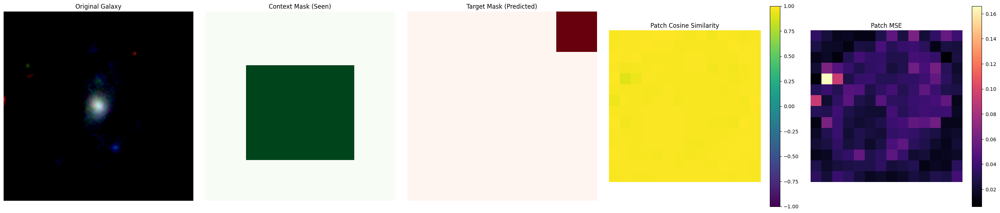

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1408
Avg Cosine: 0.98269457
Avg MSE: 0.031742886

=== Visualizing anomaly at index 921 ===


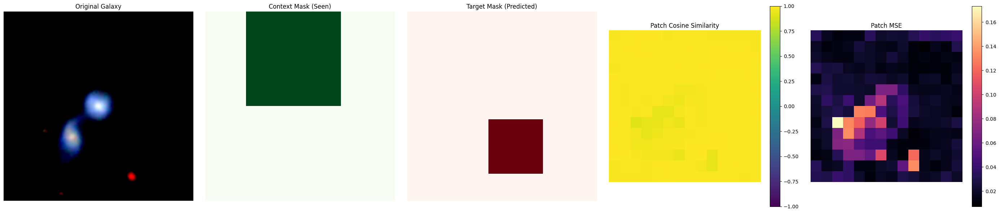

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 921
Avg Cosine: 0.9834442
Avg MSE: 0.030135475

=== Visualizing anomaly at index 1031 ===


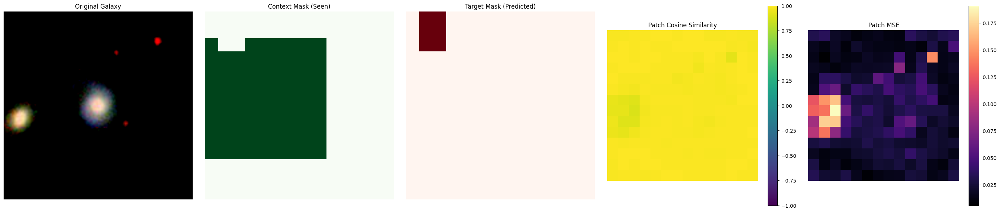

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1031
Avg Cosine: 0.98201877
Avg MSE: 0.032665696

=== Visualizing anomaly at index 385 ===


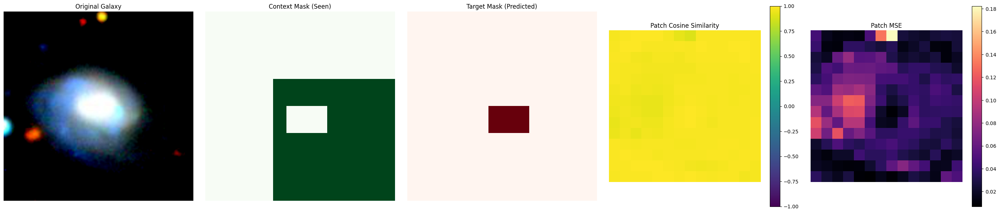

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 385
Avg Cosine: 0.97654426
Avg MSE: 0.042380232

=== Visualizing anomaly at index 1705 ===


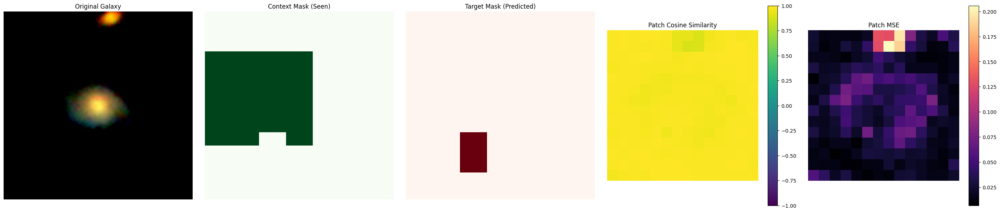

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1705
Avg Cosine: 0.9816144
Avg MSE: 0.033341296

=== Visualizing anomaly at index 1273 ===


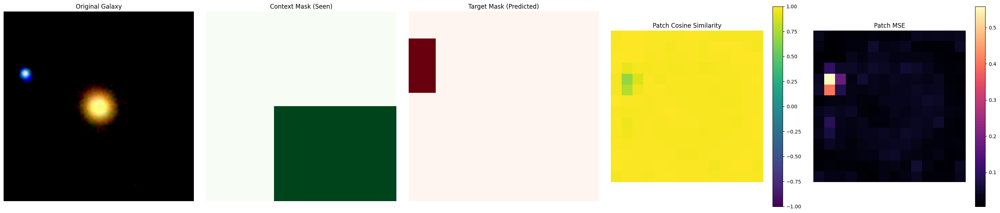

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1273
Avg Cosine: 0.98103786
Avg MSE: 0.03444323

=== Visualizing anomaly at index 1334 ===


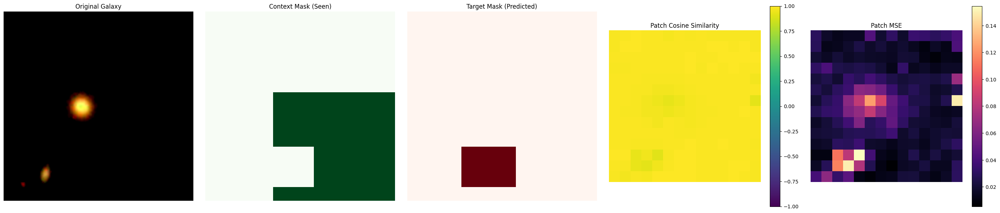

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1334
Avg Cosine: 0.98366314
Avg MSE: 0.029782414

=== Visualizing anomaly at index 1036 ===


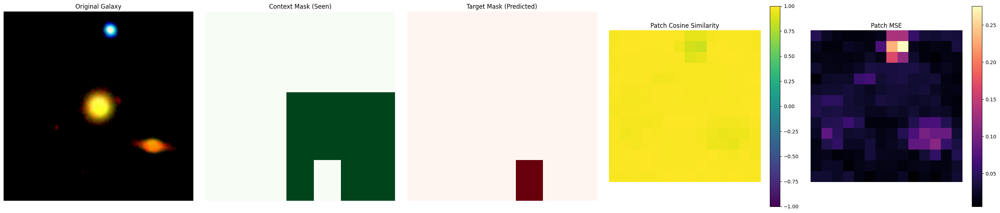

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1036
Avg Cosine: 0.9812589
Avg MSE: 0.034001466

=== Visualizing anomaly at index 1757 ===


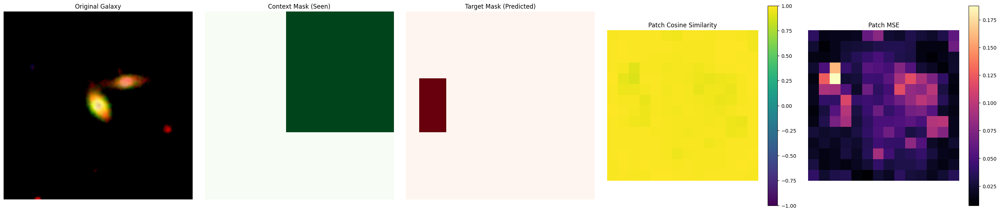

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1757
Avg Cosine: 0.9773287
Avg MSE: 0.04086914

=== Visualizing anomaly at index 277 ===


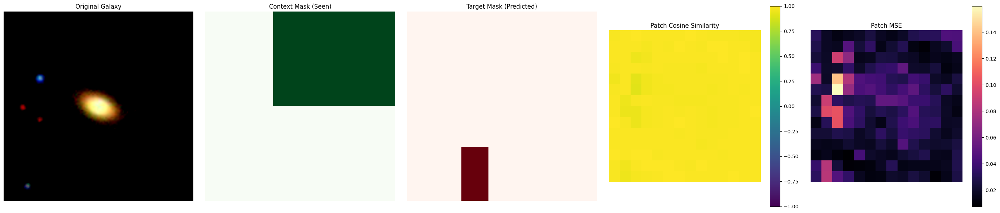

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 277
Avg Cosine: 0.9832603
Avg MSE: 0.030508678

=== Visualizing anomaly at index 624 ===


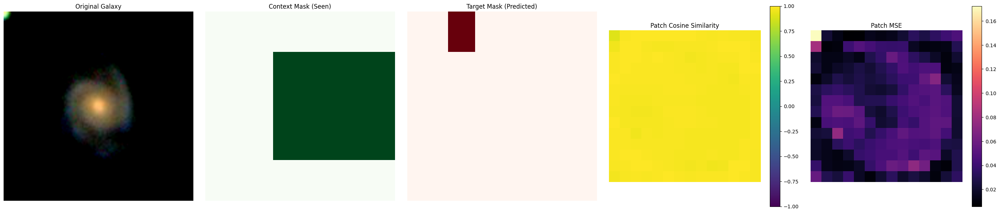

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 624
Avg Cosine: 0.9815183
Avg MSE: 0.033617888

=== Visualizing anomaly at index 1677 ===


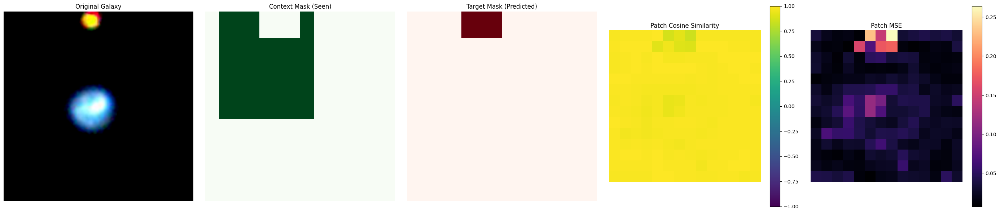

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1677
Avg Cosine: 0.9808119
Avg MSE: 0.0347594

=== Visualizing anomaly at index 1299 ===


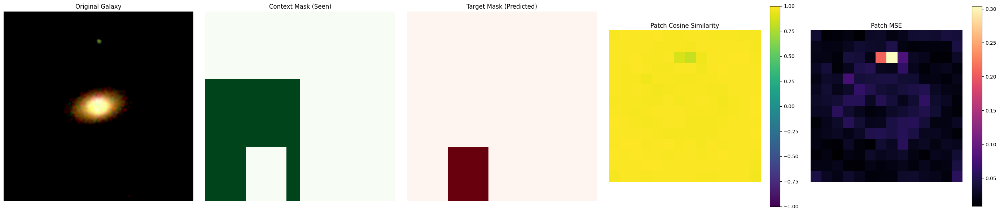

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1299
Avg Cosine: 0.98263675
Avg MSE: 0.03162244

=== Visualizing anomaly at index 1293 ===


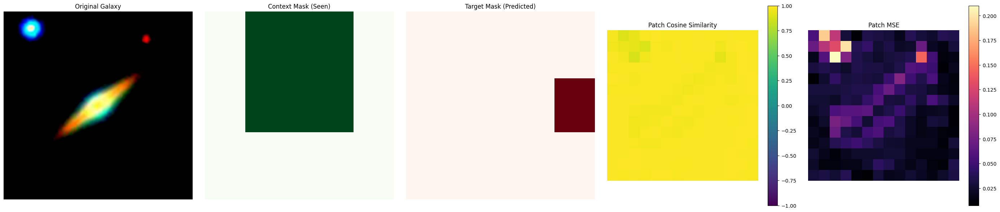

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1293
Avg Cosine: 0.9804672
Avg MSE: 0.035509877

=== Visualizing anomaly at index 523 ===


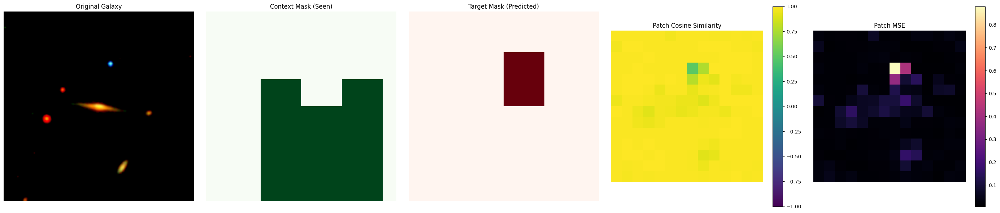

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 523
Avg Cosine: 0.9777864
Avg MSE: 0.04001502

=== Visualizing anomaly at index 846 ===


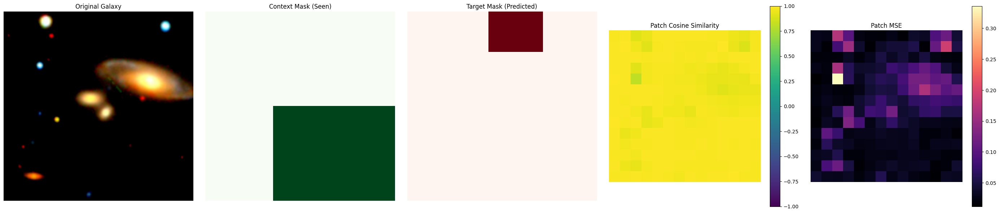

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 846
Avg Cosine: 0.9727498
Avg MSE: 0.048944823

=== Visualizing anomaly at index 565 ===


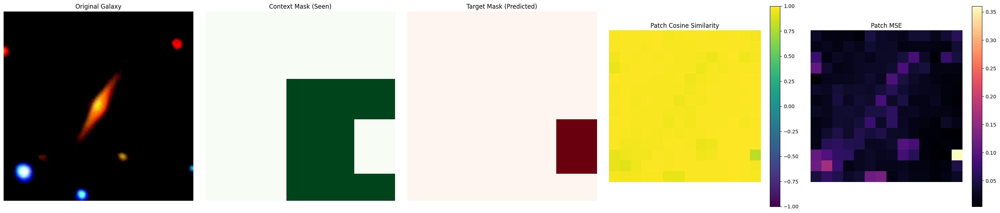

Random galaxy index: 565
Avg Cosine: 0.9798157
Avg MSE: 0.036688086

=== Visualizing anomaly at index 492 ===


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


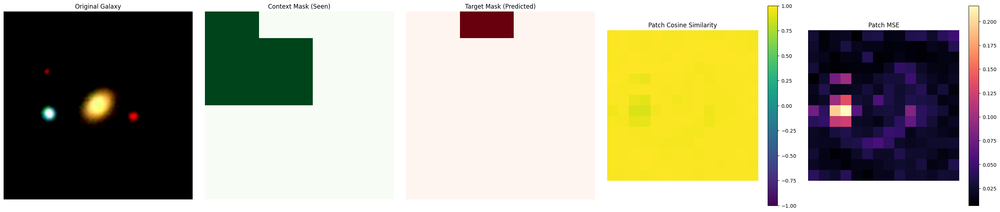

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 492
Avg Cosine: 0.9838214
Avg MSE: 0.029496087

=== Visualizing anomaly at index 1503 ===


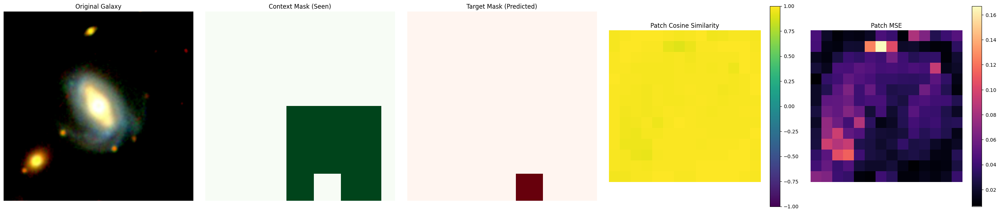

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1503
Avg Cosine: 0.9799294
Avg MSE: 0.036418743

=== Visualizing anomaly at index 1402 ===


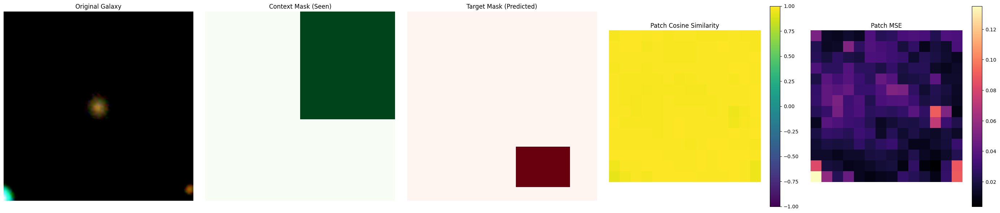

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1402
Avg Cosine: 0.9855566
Avg MSE: 0.02647381

=== Visualizing anomaly at index 1712 ===


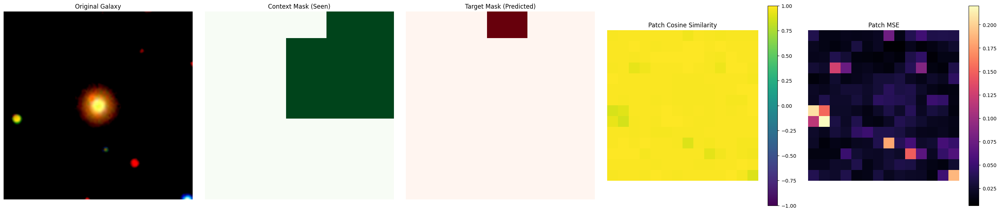

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1712
Avg Cosine: 0.9825757
Avg MSE: 0.031700883

=== Visualizing anomaly at index 1164 ===


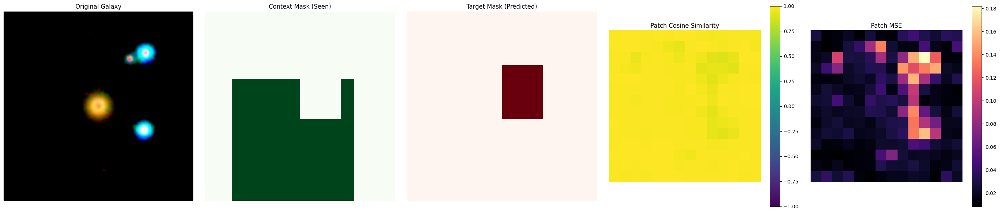

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1164
Avg Cosine: 0.98042
Avg MSE: 0.035374075

=== Visualizing anomaly at index 1258 ===


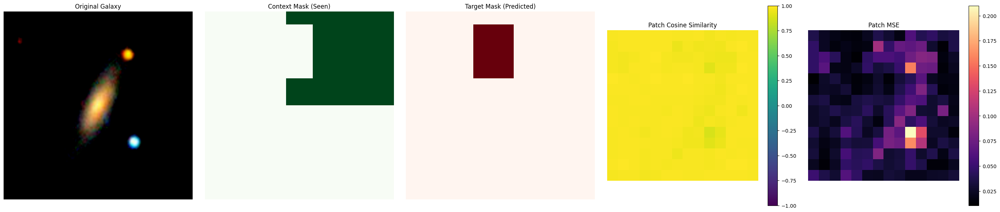

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Random galaxy index: 1258
Avg Cosine: 0.97831386
Avg MSE: 0.039253216

=== Visualizing anomaly at index 344 ===


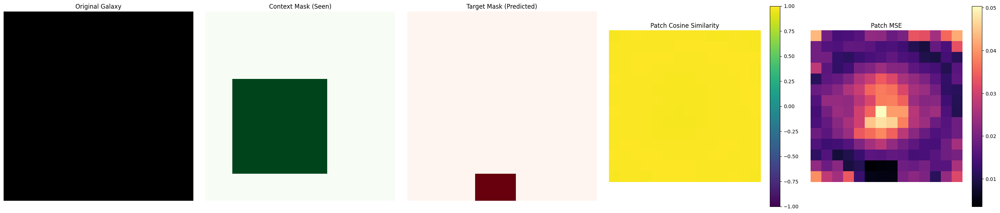

Random galaxy index: 344
Avg Cosine: 0.988674
Avg MSE: 0.020942757


In [87]:
for idx in top_idx:
    print(f"\n=== Visualizing anomaly at index {idx} ===")
    visualize_full_latent_map(model, test_subset, idx=idx, device='cuda')


In [89]:
import torch
import numpy as np
from tqdm import tqdm

def kmeans_torch(X, num_clusters=10, num_iters=50, device='cpu'):
    """
    Simple PyTorch KMeans for clustering latent vectors.
    X: numpy array of shape (N, D)
    """
    X = torch.tensor(X, dtype=torch.float32).to(device)
    N, D = X.shape

    # randomly pick initial centroids
    indices = torch.randperm(N)[:num_clusters]
    centroids = X[indices]

    for _ in tqdm(range(num_iters)):
        # compute distances to each centroid
        distances = torch.cdist(X, centroids)

        # assign each point to nearest centroid
        labels = distances.argmin(dim=1)

        # recompute centroids
        new_centroids = []
        for k in range(num_clusters):
            cluster_points = X[labels == k]
            if len(cluster_points) == 0:
                new_centroids.append(centroids[k])
            else:
                new_centroids.append(cluster_points.mean(dim=0))
        centroids = torch.stack(new_centroids)

    return labels.cpu().numpy(), centroids.cpu().numpy()


In [96]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
clusters, centers = kmeans_torch(latents, num_clusters=10, device=device)


100%|██████████| 50/50 [00:00<00:00, 823.48it/s]


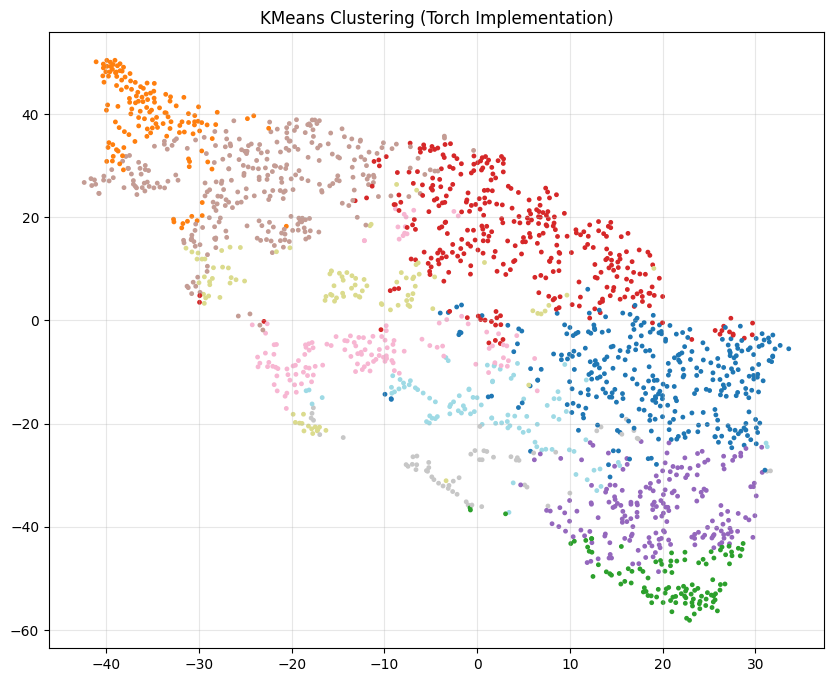

In [97]:
plt.figure(figsize=(10,8))
plt.scatter(
    embedding_tsne[:,0], embedding_tsne[:,1],
    c=clusters, cmap='tab20', s=6
)
plt.title("KMeans Clustering (Torch Implementation)")
plt.grid(alpha=0.3)
plt.show()


In [98]:
import numpy as np
from collections import Counter

true_labels = labels  # from your dataset
cluster_ids = clusters  # from KMeans

num_clusters = len(np.unique(cluster_ids))

print("\n=== Cluster Purity ===\n")
for k in range(num_clusters):
    mask = cluster_ids == k
    assigned = true_labels[mask]
    if len(assigned) == 0:
        continue
    
    counts = Counter(assigned)
    dominant_cls, count = counts.most_common(1)[0]
    purity = count / len(assigned)
    
    print(f"Cluster {k}: size={len(assigned)}, "
          f"dominant={dominant_cls}, purity={purity:.3f}, "
          f"class_counts={dict(counts)}")



=== Cluster Purity ===

Cluster 0: size=316, dominant=2, purity=0.228, class_counts={7: 60, 0: 21, 2: 72, 1: 32, 4: 4, 6: 43, 3: 35, 5: 43, 9: 6}
Cluster 1: size=137, dominant=2, purity=0.365, class_counts={2: 50, 3: 33, 1: 10, 9: 27, 8: 2, 0: 6, 5: 2, 4: 2, 6: 2, 7: 3}
Cluster 2: size=106, dominant=6, purity=0.283, class_counts={6: 30, 7: 25, 1: 11, 2: 8, 5: 25, 0: 4, 8: 1, 3: 2}
Cluster 3: size=334, dominant=7, purity=0.201, class_counts={7: 67, 2: 61, 3: 64, 1: 29, 9: 10, 0: 23, 6: 37, 5: 38, 4: 5}
Cluster 4: size=192, dominant=6, purity=0.240, class_counts={6: 46, 7: 35, 3: 8, 5: 38, 0: 14, 1: 21, 2: 22, 9: 6, 8: 2}
Cluster 5: size=300, dominant=3, purity=0.193, class_counts={1: 29, 7: 30, 4: 20, 8: 16, 2: 50, 9: 54, 6: 11, 3: 58, 0: 20, 5: 12}
Cluster 6: size=132, dominant=8, purity=0.364, class_counts={5: 4, 0: 10, 9: 31, 7: 15, 8: 48, 6: 2, 4: 4, 3: 3, 1: 14, 2: 1}
Cluster 7: size=58, dominant=8, purity=0.276, class_counts={9: 7, 8: 16, 5: 10, 7: 7, 6: 6, 1: 9, 0: 3}
Cluster 8:

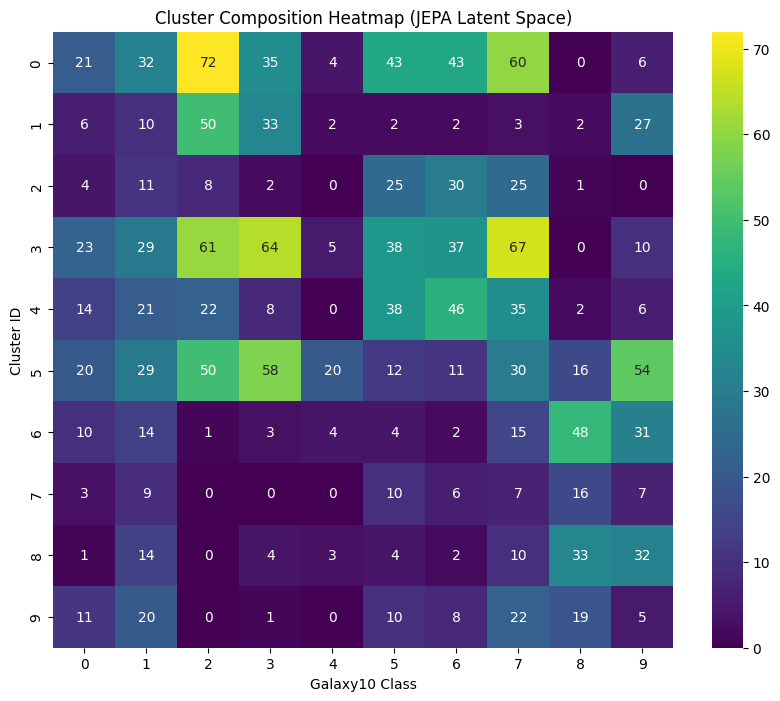

In [99]:
import seaborn as sns
import matplotlib.pyplot as plt

heatmap = np.zeros((10, 10))

for c in range(10):
    for t in range(10):
        heatmap[c, t] = np.sum((clusters == c) & (true_labels == t))

plt.figure(figsize=(10,8))
sns.heatmap(heatmap, annot=True, fmt=".0f", cmap="viridis")
plt.xlabel("Galaxy10 Class")
plt.ylabel("Cluster ID")
plt.title("Cluster Composition Heatmap (JEPA Latent Space)")
plt.show()


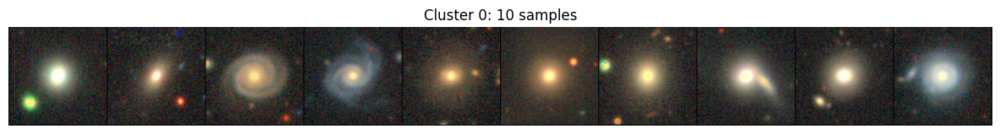

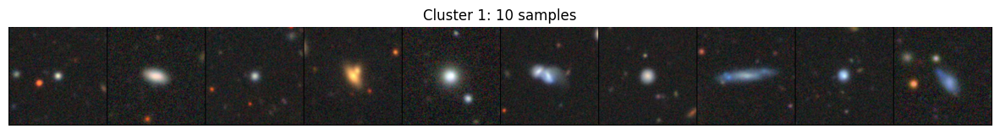

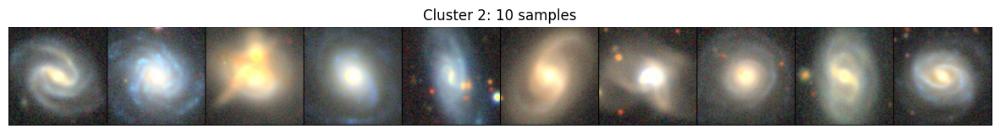

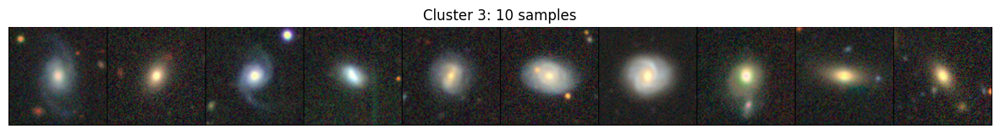

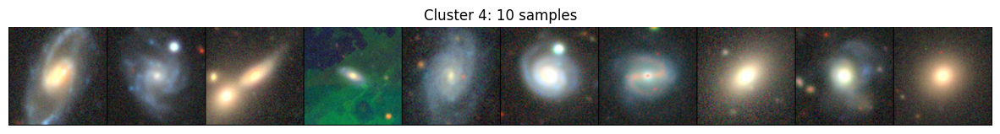

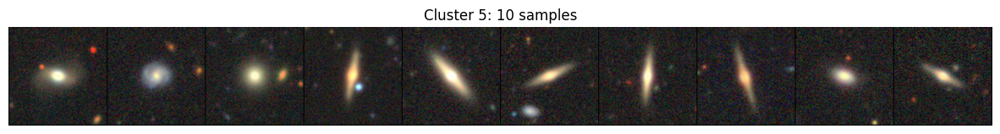

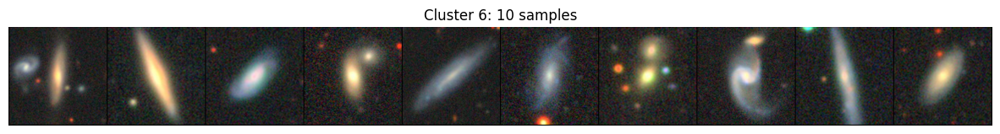

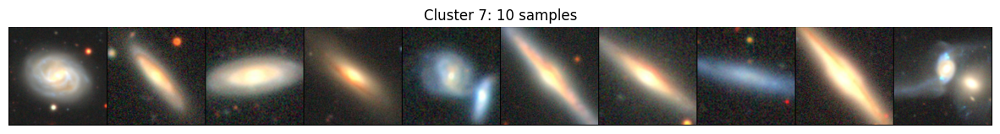

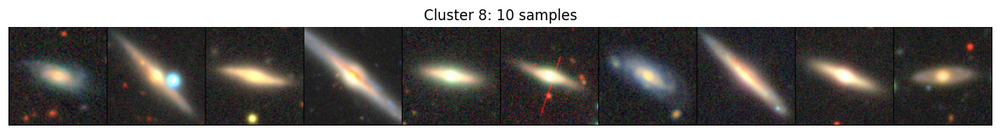

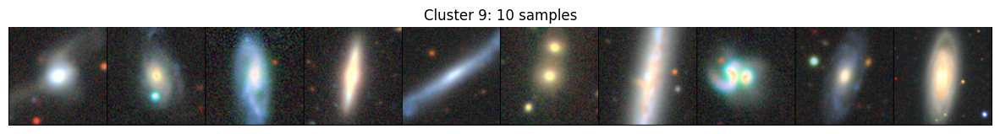

In [100]:
import random
from torchvision.utils import make_grid

def show_cluster_samples(dataset, cluster_ids, cluster, n=10):
    idxs = np.where(cluster_ids == cluster)[0]
    idxs = np.random.choice(idxs, size=min(n, len(idxs)), replace=False)

    imgs = [dataset[i][0] for i in idxs]  # CHW tensors
    imgs = torch.stack(imgs)
    grid = make_grid(imgs, nrow=n, normalize=True)

    plt.figure(figsize=(15,3))
    plt.imshow(grid.permute(1,2,0))
    plt.axis("off")
    plt.title(f"Cluster {cluster}: {len(idxs)} samples")
    plt.show()

for c in range(10):
    show_cluster_samples(test_subset, clusters, c)


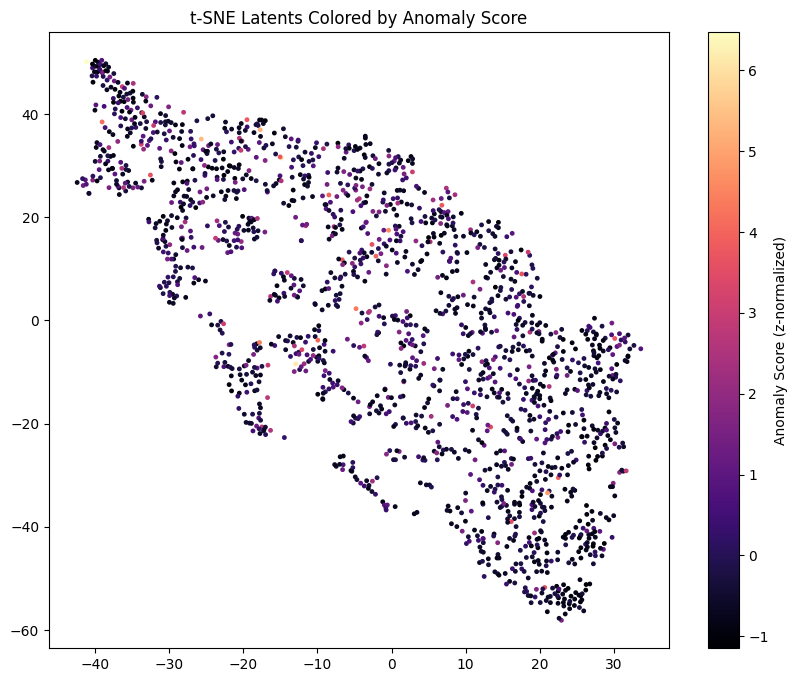

In [101]:
from scipy.stats import zscore

anomaly_scores_z = zscore(anomaly_scores)

plt.figure(figsize=(10,8))
plt.scatter(
    embedding_tsne[:,0], embedding_tsne[:,1],
    c=anomaly_scores_z, cmap="magma", s=6
)
plt.colorbar(label="Anomaly Score (z-normalized)")
plt.title("t-SNE Latents Colored by Anomaly Score")
plt.show()


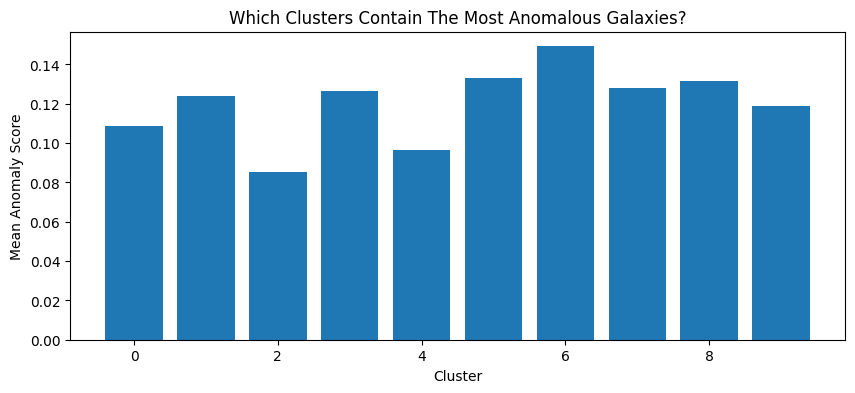

In [102]:
cluster_anomaly_mean = []
for k in range(10):
    mask = clusters == k
    cluster_anomaly_mean.append(anomaly_scores[mask].mean())

plt.figure(figsize=(10,4))
plt.bar(range(10), cluster_anomaly_mean)
plt.xlabel("Cluster")
plt.ylabel("Mean Anomaly Score")
plt.title("Which Clusters Contain The Most Anomalous Galaxies?")
plt.show()


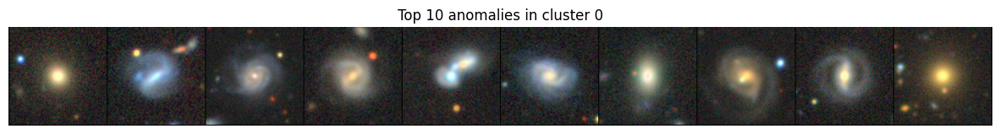

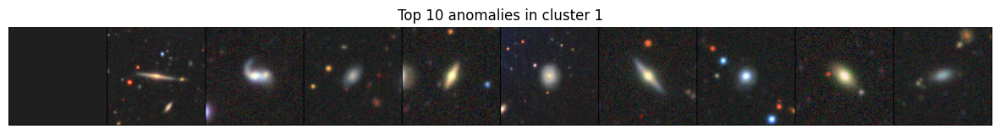

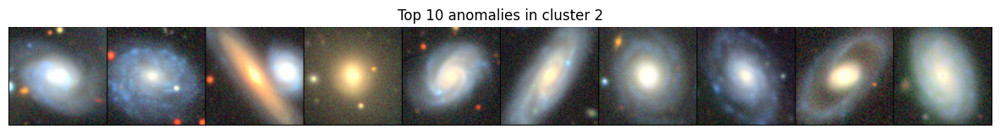

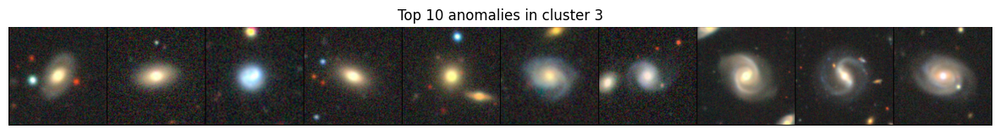

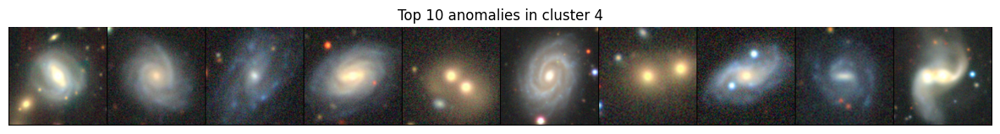

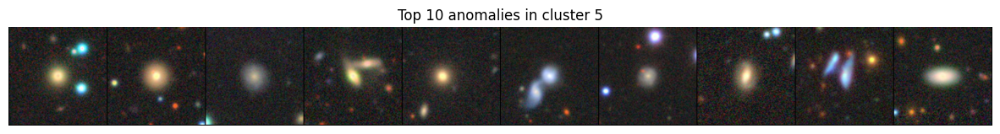

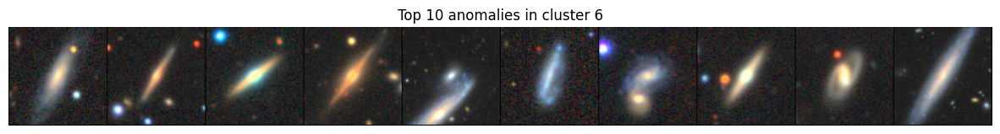

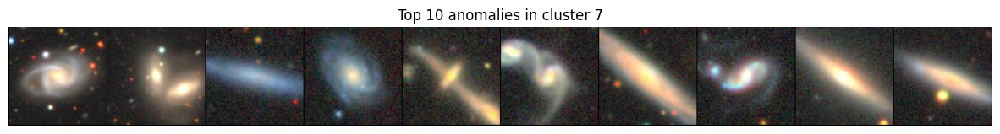

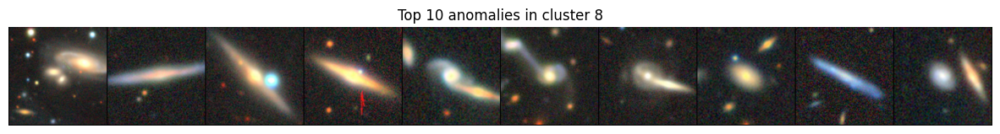

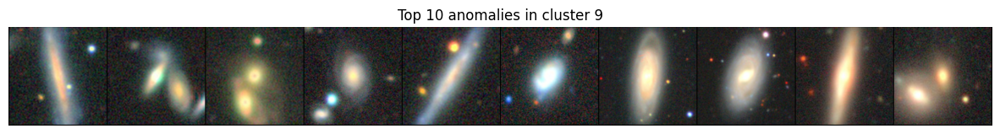

In [103]:
def show_top_anomalies(cluster, top_n=10):
    idxs = np.where(clusters == cluster)[0]
    idxs = idxs[np.argsort(-anomaly_scores[idxs])]  # descending
    top_idxs = idxs[:top_n]

    imgs = [test_subset[i][0] for i in top_idxs]
    imgs = torch.stack(imgs)
    grid = make_grid(imgs, nrow=top_n, normalize=True)

    plt.figure(figsize=(15,3))
    plt.imshow(grid.permute(1,2,0))
    plt.axis("off")
    plt.title(f"Top {top_n} anomalies in cluster {cluster}")
    plt.show()

for c in range(10):
    show_top_anomalies(c)


In [104]:
import numpy as np

densities = []
for i in range(len(embedding_tsne)):
    d = np.mean(np.linalg.norm(embedding_tsne - embedding_tsne[i], axis=1))
    densities.append(d)

densities = np.array(densities)


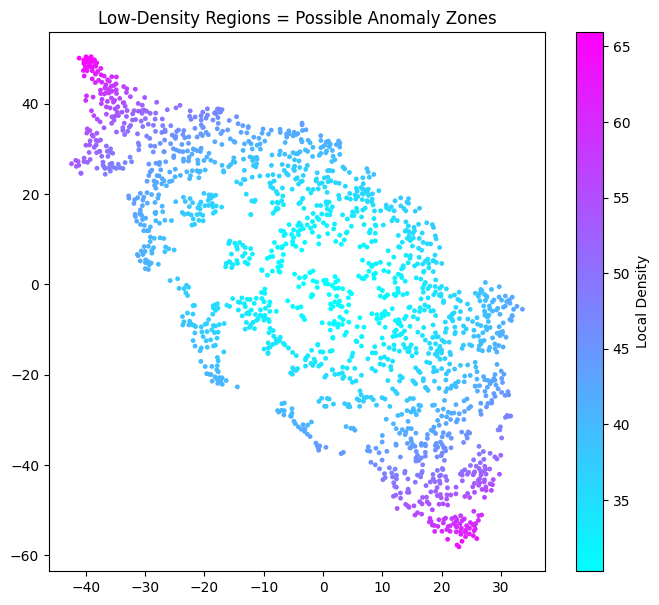

In [106]:
plt.figure(figsize=(8,7))
plt.scatter(
    embedding_tsne[:,0],
    embedding_tsne[:,1],
    c=densities,
    cmap='cool',
    s=6
)
plt.colorbar(label='Local Density')
plt.title('Low-Density Regions = Possible Anomaly Zones')
plt.show()


In [107]:
def find_internal_anomalies(cluster_id, k=3):
    idxs = np.where(clusters == cluster_id)[0]
    X = latents[idxs]

    sub_labels, _ = kmeans_torch(X, num_clusters=k)
    return idxs, sub_labels


100%|██████████| 50/50 [00:00<00:00, 1615.47it/s]


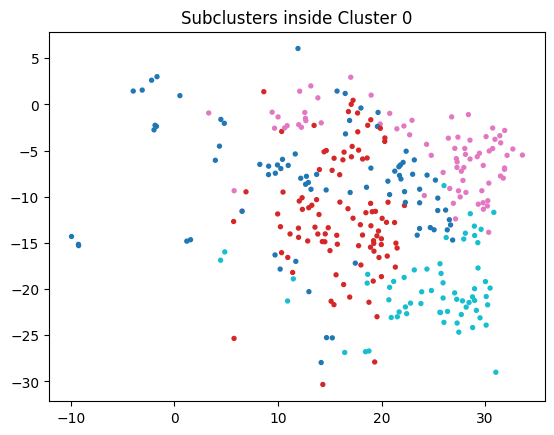

In [108]:
idxs, subs = find_internal_anomalies(0, k=4)
plt.scatter(
    embedding_tsne[idxs, 0],
    embedding_tsne[idxs, 1],
    c=subs,
    cmap='tab10',
    s=8
)
plt.title("Subclusters inside Cluster 0")
plt.show()
